In [ ]:
#!pip3 install --user --upgrade git+https://github.com/twintproject/twint.git@origin/master#egg=twint

In [ ]:
#!pip freeze

In [37]:
!pip install textblob

  Using cached textblob-0.17.1-py2.py3-none-any.whl (636 kB)
  Using cached nltk-3.7-py3-none-any.whl (1.5 MB)
  Using cached joblib-1.2.0-py3-none-any.whl (297 kB)
  Using cached regex-2022.10.31-cp39-cp39-win_amd64.whl (267 kB)
  Using cached tqdm-4.64.1-py2.py3-none-any.whl (78 kB)

[notice] A new release of pip available: 22.2 -> 22.3.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [38]:
import twint
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import nest_asyncio
import re
from textblob import TextBlob
from nltk.tokenize import WordPunctTokenizer
from nltk.corpus import stopwords   
from datetime import datetime
import glob                     
import os
nest_asyncio.apply()
#from sqlalchemy import create_engine

In [10]:
# bank_name={'Guarantee Trust Bank':'gtb OR \ gtbank',
#     'First Bank':'first bank OR \ fbn',
#     'Zenith Bank':'zenith bank',
#     'UBA':'UBA',
#     'Access Bank':'access bank',
#     'Fidelity Bank':'fidelity bank',
#     'Eco Bank':'eco bank',
#     'Wema Bank':'wema bank',
#     'Kuda bank':'kuda bank',
#     'Opay':'opay'}

In [4]:
bank_name={'Guarantee Trust Bank':'gtb OR \ gtbank',
    'Zenith Bank':'zenith bank',
    'UBA':'UBA',
    'Access Bank':'access bank',
    'Fidelity Bank':'fidelity bank',
    'Eco Bank':'eco bank',
    'First Bank':'first bank',
    'Wema Bank':'wema bank',
    'Kuda bank':'kuda bank',
    'Opay':'opay'}

In [5]:
def twintConfig(search_string):
    c = twint.Config()
    c.Search = search_string[1]
    c.Limit=500
    c.Lang = 'en'
    c.Pandas = True
    c.Pandas_au = True          
    c.Pandas_clean=True
    c.Since='2022-01-01'
    c.Until='2022-12-31'
    twint.run.Search(c)

In [6]:
def Run_Twint(search_vals):
    
    #set empty dataframe for join
    out_df= pd.DataFrame()
    
    for bank in search_vals.items():
        print ("running for search item: "+bank[0]+"\n")
        print ("Search string: "+bank[1]+"\n")
        
        #run twint
        twintConfig(bank)
        
        #get dataframe
        tweets_df = twint.storage.panda.Tweets_df
        
        #join Dataframes and create 'Bank' column
        tweets_df["Bank"]= bank[0]
        out_df = pd.concat([out_df,tweets_df])
        
    return out_df

In [7]:
tweets_df = Run_Twint(bank_name)

running for search item: Guarantee Trust Bank

Search string: gtb OR \ gtbank

1590317379988643841 2022-11-09 13:16:24 +0100 <sdeenworld> @gtbank for the past 5 days now my complaints is yet to be resolved. 08029002900 is not connecting, WhatsApp messenger is an error too. This is not just good.... It's bad.
1590317339903684608 2022-11-09 13:16:15 +0100 <favourijesuobo> @Realnoni4Real Omo nah GTBank oh
1590317210551349254 2022-11-09 13:15:44 +0100 <EzeSams49773090> @SciDamola 0593868143 Gtbank Eze Samson chinemeremogo  Thank u sir
1590317196076453888 2022-11-09 13:15:40 +0100 <Kovnificent> Lmao honestly nothing concern GTB with banking. The most worst.
1590317124206985216 2022-11-09 13:15:23 +0100 <59Gtb> #PS5Share, #ELDENRING #レベル1の旅  https://t.co/55EadKdqr4
1590316983979212810 2022-11-09 13:14:50 +0100 <hiro355gtb> @hige_boze_ 10年くらい前高阪のマスターに勧められて飲んでました
1590316928765394944 2022-11-09 13:14:37 +0100 <Marvell25038123> @sportingking365 0528669841 Gtbank
1590316869013344256 2022-11-09 13

1590314231009660928 2022-11-09 13:03:53 +0100 <BlessedBunmi5> @Realnoni4Real 0012555959 GTBANK
1590314189255761920 2022-11-09 13:03:43 +0100 <Oladosuolamid19> @Realnoni4Real Account number: 0241481928 Account name: Oladosu Olamide Rokeeb  Bank: GTBank
1590314180380282880 2022-11-09 13:03:41 +0100 <oyesolaoluwabu3> @brainjotter__ 0249905866 oyesola olubusayo gtbank
1590314143781093376 2022-11-09 13:03:33 +0100 <LuJay_Rex> @Realnoni4Real 0012034537 Gtbank Oluwashola
1590314108129546241 2022-11-09 13:03:24 +0100 <elvisomton> @sportingking365 @sportingking365  abeg pick me ...0456251716 GTB Nwankwo Elvis....I have been following you for a long while haven't gotten lucky enough to win from your games or giveaway but today I know say you go see me today credit me
1590314072893186052 2022-11-09 13:03:16 +0100 <LuJay_Rex> @Realnoni4Real 0208622597 Gtbank Lucy Jonah.
1590314005041512448 2022-11-09 13:03:00 +0100 <Hussainmanofin1> @Realnoni4Real 0106396677 Gtbank  Hussaini Haruna
159031389270548

1590309691904909316 2022-11-09 12:45:51 +0100 <PreciousAburime> @sportingking365 SportingKING  0163616444 Gtb  I will for ever be grateful  exspecially now that I need money for my school. Thanks God bless u sir
1590309683079696385 2022-11-09 12:45:49 +0100 <lilymaky72> @Realnoni4Real Modebelu lilian chiamaka 0040531583 gtb
1590309683067498497 2022-11-09 12:45:49 +0100 <Motor1argentina> Centro Milano, importador de Ferrari, lanzará a la venta en Argentina tres modelos con los siguientes precios: -SF90 Stradale: 1.100.000 dólares Frank Sinatra. -Roma: 950.000 dólares Frank Sinatra. -296 GTB: 800.000 dólares Frank Sinatra. Más:  https://t.co/lQcxrbGjzL  https://t.co/B8pLq0vziF
1590309610510241792 2022-11-09 12:45:32 +0100 <Crane849539591> @PulseNigeria247 Oboy both
1590309524988383233 2022-11-09 12:45:11 +0100 <YourBoiTunde> @sportingking365 Sportingking 0122413105 GTB  https://t.co/DHrrMbenuP
1590309482856591361 2022-11-09 12:45:01 +0100 <Delisa_Lockey> @Kim_TDHSN @5ecretNumber Pas GTB 

1590306163396337669 2022-11-09 12:31:50 +0100 <ogunlanaadefol2> @sportingking365 Sportingking 0479790580 gtb
1590306119771033601 2022-11-09 12:31:40 +0100 <aniokenwanyi07> @DAMIADENUGA I will use it to pay part of my house rent God bless the giver Amen  Ani Anastasia Chidinma  0170372122 GTBank
1590306095851245569 2022-11-09 12:31:34 +0100 <EzeSams49773090> @brainjotter__ Pls I have been following and dropping my account number but nothing.  But remember me today   0593868143 Gtbank Eze Samson chinemeremogo #15YearsWithitel
1590306069221609473 2022-11-09 12:31:28 +0100 <Olamide30133> @Realnoni4Real Bossman, I'm on God pls notice me too it's been a while now since I have been dropping my account details hoping that you will put a smile on my face by seeing your alert vibrate on the screen of my phone, I'm still hoping sir.  O157096845, gtb Mohammed Abdulraheem Olamide
1590306062204182528 2022-11-09 12:31:26 +0100 <Gjenericbabe> @brainjotter__ First, I will pay my baby's medical bills, t

1590303542593867776 2022-11-09 12:21:25 +0100 <92Gtb> @shariwa_ 😂
1590303540492521472 2022-11-09 12:21:25 +0100 <hackaxii> @Adazoee 🤣🤣🤣🤣 you can move your funds to a better bank though @gtbank
1590303503402295298 2022-11-09 12:21:16 +0100 <tt_signatures> @ENLIGHT3845 @ademoye_mercy Hello O215808016 Gtb
1590303371478827011 2022-11-09 12:20:44 +0100 <fxcryptovix> GTBANK 0030433219 Thanks
1590303346153250818 2022-11-09 12:20:38 +0100 <Olamideolawale2> @debornair99 @olami_de01 @debornair99 0152968204 Salawu Olawale Olamide GTBank
1590303308966948871 2022-11-09 12:20:29 +0100 <WilliamsOyebola> @sportingking365 Sporting king 0150963793 GTbank  Bless me boss
1590303302595379201 2022-11-09 12:20:28 +0100 <JonzingWurld> Sportingking Sportingking  Sportingking Sportingking Sportingking  Sportingking Sportingking Sportingking  Sportingking Sportingking Sportingking  Sportingking Sportingking Sportingking  Sportingking Sportingking Sportingking  0244636217 Gtbank  Please pick me boss🥺🤲🏽
1590303296

1590300168057823233 2022-11-09 12:08:01 +0100 <NwazueKelechi> @sportingking365 Sportingking 0242690251 GTB Nwazue Kelechi
1590300159346610176 2022-11-09 12:07:58 +0100 <mikekunle6> @sportingking365 0045018076, GTB
1590300149712289792 2022-11-09 12:07:56 +0100 <MurtadohRaji> @fagalex67 @Ekitipikin 0670094511 gtb, boss bless me too
1590300135485210625 2022-11-09 12:07:53 +0100 <duchessofpeace> @sportingking365 @sportingking365 giveaway dey sure die, people done dey win, today na my day for sure to win too.  Pass me not, o gentle Sportingking  Sportingking  GTBank 0234019642  Sporting king God bless you forever  https://t.co/7qgxjC1G3H
1590300110940176386 2022-11-09 12:07:47 +0100 <HassanA22067956> @Realnoni4Real GTB 0140173160 HASSAN ADEKUNLE
1590300081361559552 2022-11-09 12:07:40 +0100 <raphzilahj> @Realnoni4Real 0539474944  Gtbank your concern will be highly appreciated 🙏
1590300073166094337 2022-11-09 12:07:38 +0100 <gtbank_help> @Naija_Rosa Hello.   Thank you for talking to us. Kind

1590297920271945728 2022-11-09 11:59:05 +0100 <CrezSophie> @Realnoni4Real 0232942843..Gtbank🤲
1590297914609324032 2022-11-09 11:59:03 +0100 <Demilad47585697> @sportingking365 Sportingking 0198735512 Gtbank. Thanks boss. God bless
1590297897815318529 2022-11-09 11:58:59 +0100 <Niolagold21> @Realnoni4Real 0178538180 Gtbank
1590297895311663105 2022-11-09 11:58:59 +0100 <Benevol5143> @Betodds1 0667778989 GTB my boss
1590297854475915264 2022-11-09 11:58:49 +0100 <JoshuaAbumere> 0465413512 GTBank
1590297853595095041 2022-11-09 11:58:49 +0100 <AkibuIfeoluwa> @gtbank_help where is my money o 😏
1590297851963510785 2022-11-09 11:58:48 +0100 <timothyakanji> @brainjotter__ Abeg o. Am a tailor and I need it to buy materials for my work and chicken I want to rear. GTB, Akanji Timothy A, 0174763751. #FouryyNoble
1590297744228638721 2022-11-09 11:58:23 +0100 <mhizzzleah> @sportingking365 @sportingking365 0162467546 GTB. God bless you
1590297727942135810 2022-11-09 11:58:19 +0100 <ebbycyclux> @gtbank_h

1590295935489544193 2022-11-09 11:51:11 +0100 <Blaccheffe> @Realnoni4Real Boss abeg Look at me 0261498928 Gtbank
1590295884411305989 2022-11-09 11:50:59 +0100 <OlasunkanmiAji5> @NigLegalView 0137065582 gtb
1590295829218152448 2022-11-09 11:50:46 +0100 <iam_samwonder> @Realnoni4Real Good day sir, 0124468051 Gtbank. Thank you and God bless
1590295822893084674 2022-11-09 11:50:45 +0100 <MubarakOlaoye1> @Realnoni4Real 0213383922 GTbank….. please notice me sir 🙏🏻😭
1590295811497562112 2022-11-09 11:50:42 +0100 <majestainless> @gtbank_help  please someone jaut sent money to my account ,I have credit alert but not reflected in my balance,how do I get my money in my account like this poo???
1590295764798181376 2022-11-09 11:50:31 +0100 <Darry6ix> @sportingking365 Sportingking baba nla  0235981261 gtb  On God 😂
1590295736947990530 2022-11-09 11:50:24 +0100 <simi_similoluwa> @Realnoni4Real 0198566246 GTB Eweobaja olorunfemi
1590295731755438082 2022-11-09 11:50:23 +0100 <NURUDEENOLUSESI> @sporting

1590317502089035782 2022-11-09 13:16:53 +0100 <OkporuanefeV> @Realnoni4Real 2678565790 Okporuanefe victory Zenith bank
1590317497131012096 2022-11-09 13:16:52 +0100 <Olajide170592> @sportingking365 Sportingking agba ponter..bless you in all ramifications 2084520874 zenith bank
1590317428546076673 2022-11-09 13:16:36 +0100 <NdiliUgochukwu> @sportingking365 Sporting king  2176773890. Zenith bank
1590317388377255936 2022-11-09 13:16:26 +0100 <YemgbeS> @Realnoni4Real 2531446443 Zenith bank  Yemgbe Godknows
1590317314087751682 2022-11-09 13:16:09 +0100 <dandija001> @ZenithBank Useless bank  THIEVES  HONESTLY I REGRET BANKING WITH YOU 🤬🤬
1590317220617678848 2022-11-09 13:15:46 +0100 <Baycon2> @sportingking365 2111489556 Zenith bank Oluwaseun Bayode
1590317214397526016 2022-11-09 13:15:45 +0100 <Tiwatemmy08> @sportingking365 @sportingking365 @sportingking365 @sportingking365 @sportingking365 @sportingking365 @sportingking365 @sportingking365 @sportingking365  2085217609 Zenith bank Joseph tem

1590310017219325952 2022-11-09 12:47:09 +0100 <victoriatambiri> @Realnoni4Real 2252244413 zenith bank
1590309852597063681 2022-11-09 12:46:30 +0100 <Dannyjay2022> @sportingking365 SportingKing 2212200733 Zenith bank
1590309680517349376 2022-11-09 12:45:49 +0100 <EverBanging> @ZenithBank It will not be well with you guys.
1590309611013226501 2022-11-09 12:45:32 +0100 <Princes83592684> @Realnoni4Real I have never been credited before o 2083390409(Zenith bank
1590309513349193728 2022-11-09 12:45:09 +0100 <Lord_jason1x> @bookiesnitmare @bookiesnitmare baba make send your boy 2k for lunch 2398994334 Zenith Bank 😭😭
1590309278845661191 2022-11-09 12:44:13 +0100 <clement_onwada> @Realnoni4Real 2189294162 zenith bank Clement Onwada A
1590309276983390208 2022-11-09 12:44:12 +0100 <AduBlessing12> @Realnoni4Real 2051339395 Zenith Bank Olorunseyi Phillip oluwayemi
1590309091163131905 2022-11-09 12:43:28 +0100 <idbaby16> @DAMIADENUGA Pls sir,2253511212, zenith bank..the hunger is too much,sir
159030

1590304333023051777 2022-11-09 12:24:34 +0100 <Oneluvcare> @ZenithBank Olugbode hammed Olalekan with Account number 2176617611, I bought Glo card of #1500 with the number 08077623325 on 8/11/22, at the time of 9.15am. I received debit alert on my account and they haven't credit my Glo card. Plz help me to reverse my money back.
1590304327146831875 2022-11-09 12:24:32 +0100 <AmahCynthia82> @Realnoni4Real 2267717291 Zenith bank
1590304120132755456 2022-11-09 12:23:43 +0100 <JhayseeDoll> @Realnoni4Real 2544553505 Adokeme Jessica Zenith bank
1590304063249604610 2022-11-09 12:23:29 +0100 <OSlimddy> @DAMIADENUGA 2252820049 Zenith Bank Oluwatomiwa Abiodun A
1590304039958630427 2022-11-09 12:23:24 +0100 <ziiieeez> Zenith bank is a very stvpid bank.
1590303778523164673 2022-11-09 12:22:21 +0100 <stanley_eze29> @Realnoni4Real 2081093287 zenith bank Stanley
1590303757430325249 2022-11-09 12:22:16 +0100 <nomanlikestan> @veeiye @ZenithBank  very unserious set of people, God forbid
15903036844116746

1590300101863673860 2022-11-09 12:07:45 +0100 <EmmanuelAbhish1> @sportingking365 This kind thing no dey work for me ever since I was born but I will keep pushing harder 😩 2218533499 Zenith bank. Emmanuel chukwu
1590300088429334530 2022-11-09 12:07:42 +0100 <SammyMorrisonk4> @Realnoni4Real 2110391461 Zenith bank. Please.🙏🙏🙏😭
1590299956937916417 2022-11-09 12:07:10 +0100 <SamuelM57486305> @sportingking365 @sportingking365  2289260276 Zenith bank Help me boss
1590299925623230464 2022-11-09 12:07:03 +0100 <IamTyronePriest> @ZenithBank @ZenithBank Each time I try using the app for a fund transfer/debit transaction, the response I get is "Authorization failed". Please assist with this. It's urgent.
1590299773223202817 2022-11-09 12:06:26 +0100 <CyrilAviel> Very wicked bank. They debited me 2k 2days ago. They claimed it’s paystack. I dislike Zenith bank with everything
1590299738670530560 2022-11-09 12:06:18 +0100 <thespiankadesh> @Elkrosmediahub NYSC is imposing a zenith bank account to me 😭

1590294704242847744 2022-11-09 11:46:18 +0100 <Nwafor_Gospel> @ZenithBank please check your DM
1590294699616907264 2022-11-09 11:46:17 +0100 <nathyceeJND> @sportingking365 GGMU 2548611786 Zenith Bank
1590294640829386752 2022-11-09 11:46:03 +0100 <okpescoTweets> @Realnoni4Real 2215776620 Zenithbank  My hope is In you Boss man 🙏
1590294564157689857 2022-11-09 11:45:44 +0100 <Tiwalope5> Dear @ZenithBank you people are a mess on all of your platforms I recommend you exit the banking system if you going to always make people sad over there hard earned money. Cbn needs to look into your activities. You are under performing
1590294557391888384 2022-11-09 11:45:43 +0100 <Shenanigankline> @sportingking365 @sportingking365 thank you advance 👑👑👑.   2286047126 Zenith bank
1590294511300710400 2022-11-09 11:45:32 +0100 <CGebirel> @brainjotter__ Flood invaded my area, kills many of my neighbours carries our house 🏡Cameroonian  damy lagdo2123851071 Zenith Bank 🏦 Chijioke UBA
1590294472713084928 2022-1

1590292159726784514 2022-11-09 11:36:11 +0100 <hollyMichael23> @fagalex67 @Ekitipikin Happy Birthday boss abeg nothing is too small I’m down to 0 naira .. I haven’t had breakfast 2117922387 zenith bank
1590292123873873924 2022-11-09 11:36:03 +0100 <ChildOfGrace141> @Realnoni4Real Sir pls I have Been very active for a long time and have not been credited I really need money to get foodstuffs cos I am in school and they are finished 2404543552 Zenith Bank  Ogochukwu Favour
1590292101589504000 2022-11-09 11:35:57 +0100 <ebubemira> @sportingking365 @sportingking365  pray for more win and grace sir pls remember tonight need ur favour more than ever 2110891064 zenith bank
1590292098213113856 2022-11-09 11:35:57 +0100 <tjomopastor> @brainjotter__ 2254283055. Zenith bank
1590292093032755200 2022-11-09 11:35:55 +0100 <NasikpoEsther> @Realnoni4Real Faith Esther Nasikpo-Frank 2407246218 Zenith bank savings abeg look my way have been following you for month pls remember me
1590292029195419649 2022

1590290028760281089 2022-11-09 11:27:43 +0100 <GallGutter> How hasn't @ZenithBank been called out with their terrible network and outrageous customer service
1590290011357777920 2022-11-09 11:27:39 +0100 <lordscholes1> @sportingking365 Sportingking ❤️❤️🙌 God bless you 🙏  2403450400 Zenith Bank
1590289983868313601 2022-11-09 11:27:32 +0100 <ThinktngUSD> @sportingking365 Sportingking  1006903489 Zenith bank
1590289981196873728 2022-11-09 11:27:32 +0100 <princelonglife> @sportingking365 Sportingking 👑 Sportingking 👑  Sportingking 👑 Sportingking 👑  Sportingking 👑 Sportingking 👑  Sportingking 👑 Sportingking 👑  Sportingking 👑 Sportingking 👑  Sportingking 👑 Sportingking 👑  Sportingking 👑 Sportingking 👑   Prince C ogbonna  2405503104  Zenith bank 🏦
1590289934581403649 2022-11-09 11:27:21 +0100 <Bobbykiss1970> @brainjotter__ No 33 Acc no :2401615289 Zenith Bank Temitope oyin. J
1590289923076427777 2022-11-09 11:27:18 +0100 <Abrahamwisdom10> @sportingking365 Sportyking Sportyking Sportyking Teac

1590288681990258688 2022-11-09 11:22:22 +0100 <mictosolad> @sportingking365 I pray and hope I will fall into the category of one of the winners  #sportingking 2089651186 zenith bank
1590288669054685186 2022-11-09 11:22:19 +0100 <bagggboyyymula> @sportingking365 1005999944 ZenithBank @sportingking365 🥂❤️🦅
1590288663610417155 2022-11-09 11:22:18 +0100 <Shamzzyluv> @Realnoni4Real Respect to you. I have been commenting to all your post but have never credited me. Just show me love this time. I beg... Zenithbank 2265347997 shamsideen Abdulwasiu
1590288626319257603 2022-11-09 11:22:09 +0100 <Youngmatex14> @sportingking365 @sportingking365  2208674421 Adebowale Matthew Olasunkanmi zenith Bank
1590288588541153280 2022-11-09 11:22:00 +0100 <heartmenders2> @veeiye Haa same Zenith Bank? Dem don debit everybody pkatapkata.😆😆
1590288540071387136 2022-11-09 11:21:48 +0100 <N0bodyhelp> @sportingking365 Sportingking  Bank name: Zenith bank Account number:2570929587 Victor
1590288493133299719 2022-11-0

1590286432522076160 2022-11-09 11:13:26 +0100 <MillerKingsle10> @Realnoni4Real 2428133012 Miller Kingsley Zenith Bank
1590286346505289728 2022-11-09 11:13:05 +0100 <Oluseun30191982> @Realnoni4Real 2190860598 Zeñith bank Oluwaseun
1590286294579412995 2022-11-09 11:12:53 +0100 <dahumantochi> @ZenithBank done come with another pattern o
1590286261885231104 2022-11-09 11:12:45 +0100 <BuraimohTobijah> @Realnoni4Real 2111135808 Zenith bank Tobijah Odunayo Buraimoh
1590286090455633920 2022-11-09 11:12:04 +0100 <thelastdrogo> @ZenithBank what is your problem? Someone can't even use their app anymore. Everytime I try to log into my app, I have to first say a prayer that it should allow me do transaction. You guys should better do something about this.
1590285932607188992 2022-11-09 11:11:27 +0100 <CHIAMAKA_UMEH12> @Realnoni4Real 2289081879 Umeh chiamaka Blessing Zenith bank
1590285923258073090 2022-11-09 11:11:24 +0100 <olumercyekiti> @IbkSports @debornair99 2268416436 zenith bank aluko Funmila

1590314645692174336 2022-11-09 13:05:32 +0100 <Victori22285885> @Realnoni4Real 2159254547 UBA Victoria Peter 😊🙏
1590314386648096768 2022-11-09 13:04:31 +0100 <IVY_JHAY_1> @Realnoni4Real 2163724388 Uba Madunacho ifeyinwa joy
1590314382315393025 2022-11-09 13:04:30 +0100 <chikaola29> @Realnoni4Real 2060338174, UBA… CHIKA OWABIE
1590314360966369281 2022-11-09 13:04:24 +0100 <bonaventure2606> @sportingking365 @sportingking365 2122792089 Bonaventure UBA
1590314304141950976 2022-11-09 13:04:11 +0100 <Jayjay38408909> @sportingking365 @sportingking365   2287849127 Uba  Abeggg I really need it and I will appreciate you
1590314275582935040 2022-11-09 13:04:04 +0100 <ubainternationa> Sınır tanımayan burs imkanları tanıyan sektörün büyük markası UBA International ile yüzerek de hayallerinizi gerçekleştirebilirsiniz. ABD, Kanada ve Avrupa yüzme bursları için bizi arayın, geleceğe beraber kulaç atalım!  0212 942 87 42   https://t.co/GXHCvarKS0  #burs #scholarship  https://t.co/LY541yQOni
15903142337

1590310422120648705 2022-11-09 12:48:45 +0100 <Frankcute01> @9jaDataPlug @Qbet_intl I didn't benefits from the giveaway you just did, hope this one will reach me.  2194592581 uba ugwueke Francis.
1590310387530203136 2022-11-09 12:48:37 +0100 <Emmanuel17145> @debornair99 Am not a student 2220046592 UBA
1590310342890262529 2022-11-09 12:48:26 +0100 <BruhWtf007> @alpha_apes_nft @Boobzy_Bellz @S_amad_uba @_lam_smith_ @juiceboss27 @lolol397599 @olasax20 Congratulations 🎉
1590310227689472000 2022-11-09 12:47:59 +0100 <chikaola29> @Realnoni4Real 2060338174,UBA… CHIKA OWABIE
1590310205832990720 2022-11-09 12:47:54 +0100 <RGU5ergio> @NataliaTaffarel @alexx_bar @Carinalopezm @JuanGrabois ¿Cómo vas agredir a un tipo que viene de un viaje porque a vos se te ocurre que no tiene dinero? Obvio que un profesor de la UBA con ahorros puede viajar a dónde se le canta. Es increíble lo sorete y burro  que puede ser un macrista.
1590310051587436544 2022-11-09 12:47:17 +0100 <annshuge> @Realnoni4Real 2283283

1590305963768442882 2022-11-09 12:31:02 +0100 <eaziquel> @sportingking365 @sportingking365  Pick me pick me pick me Richkid pick me for your giveaway 😭😭😭 2160278677 UBA 😩
1590305945821024256 2022-11-09 12:30:58 +0100 <Dicky88316134> @Realnoni4Real 2199074921 UBA fowowe  Help me for my Mum’s drugs
1590305901579481089 2022-11-09 12:30:48 +0100 <DANIELOKOJIE3> @Realnoni4Real 5k UBA  2123914451 Oluwatobi daniel Okojie
1590305882851938318 2022-11-09 12:30:43 +0100 <kingIsmealite> @wfjames_brown 1018223128 UBA Akanbi Ismail
1590305793249017859 2022-11-09 12:30:22 +0100 <De_tan_> @browngenesis97 @UBAGroup Scammers 😡😡
1590305752777838592 2022-11-09 12:30:12 +0100 <De_tan_> @UBAGroup @UBAGroup  return my money now 😡
1590305704803696647 2022-11-09 12:30:01 +0100 <kingIsmealite> @brainjotter__ Buy foodstuffs, baby's school fee and send some money to my mom Pls make today my lucky day sir 1018223128 UBA Akanbi Ismail  #15YearsWithitel
1590305643122286592 2022-11-09 12:29:46 +0100 <IbrahimIliasuM1>

1590302708741074951 2022-11-09 12:18:06 +0100 <NataliaTaffarel> @RGU5ergio @alexx_bar @Carinalopezm @JuanGrabois A Grabois que viaja, porque ellos si pueden. Con que Plata ? No se… un profesor de la uba puede viajar al exterior? Es monotributista clase B   No podes defender esto
1590302680345288705 2022-11-09 12:18:00 +0100 <euinnocent> @UBACares @UBAGroup  I have sent you the email response from @TurkishAirlines
1590302600494452738 2022-11-09 12:17:41 +0100 <OLUWA_SUPPORTmi> @sportingking365  sportingking  2141728883 UBA
1590302550779039744 2022-11-09 12:17:29 +0100 <tainoreels> @Realnoni4Real 2094707050 UBA
1590302532064391168 2022-11-09 12:17:24 +0100 <tamopenguin> uba a responder esto ñero no se cmo qbnwhwjw6siw
1590302531301044226 2022-11-09 12:17:24 +0100 <kellybrown1255> @Realnoni4Real 1021832265 UBA. Thank you so much 😊 🙏🙏
1590302523335639041 2022-11-09 12:17:22 +0100 <ayangbosin_sina> @Realnoni4Real 2070491153 uba ayangbosin Sina Joshua
1590302467815636992 2022-11-09 12:17:09 

1590299521577517058 2022-11-09 12:05:26 +0100 <ehiagwina_gab> @sportingking365 Sportingking remember ur boy oo 2094663477 Uba  Ehiagwina Gabriel Ohonsi...no forget ur last born boss
1590299516355633153 2022-11-09 12:05:25 +0100 <HungryMarcio> @ubyjordy1962 Non t'ho capito Ubà
1590299506687500288 2022-11-09 12:05:23 +0100 <Emmanue24614095> @Bobby97069690 @FirstClas_King 2286273657  UBA.   Anih Emmanuel chinonyelem
1590299481773608960 2022-11-09 12:05:17 +0100 <preshymax> @sportingking365 Sportingking 2221873775 UBA  https://t.co/BOHlLfgcvD
1590299478598520834 2022-11-09 12:05:16 +0100 <lilnaskid02> @brainjotter__ God will bless you  2174010795 UBA Clement clement
1590299466296619013 2022-11-09 12:05:13 +0100 <UkatuChigozie3> @sportingking365 @sportingking365   2068062534 Ukatu chigozie uba bank
1590299440342249473 2022-11-09 12:05:07 +0100 <NorahJo58637040> @Realnoni4Real 2136900296.UBA .Alegu Norah Chinelo
1590299434608254976 2022-11-09 12:05:06 +0100 <mikejoblue> @sportingking365 Spor

1590297445367709696 2022-11-09 11:57:11 +0100 <kaborijr> @sportingking365  2277419842 Yakubu Kabori UBA Bank
1590297429957816320 2022-11-09 11:57:08 +0100 <ALBizimana> @wiskid009 @be_johns @CityofKigali Uwumva yumvise je parle en général ce qui arrive kubantu benshi.iyo ukoze ibinyuranijen'itegeko uba wigometse.kandi iyo ukoze ibyemewe n'amategeko ntushobora guhanwa.
1590297424496840705 2022-11-09 11:57:06 +0100 <Doeman001> @sportingking365 @sportingking365  UBA 2118052267 DONE ☑️  https://t.co/Vb1oJMyS5O
1590297412572413958 2022-11-09 11:57:04 +0100 <Jennyscuisine> @Realnoni4Real 2110633688 Uba Ojo Janet Ajoke
1590297400232804352 2022-11-09 11:57:01 +0100 <obinna_topten> @Realnoni4Real 2146387386 OBINNA ALO UBA BANK
1590297394339463168 2022-11-09 11:56:59 +0100 <Ore_Inumidun> @sportingking365 Sportingking 2226571241 UBA
1590297389193400320 2022-11-09 11:56:58 +0100 <lanreydavid> @IbkSports @debornair99 20411502403 UBA
1590297357131730945 2022-11-09 11:56:50 +0100 <Djfabulous250> @godu

1590295655167438848 2022-11-09 11:50:05 +0100 <empror22> @Realnoni4Real 2106976186 Uba Aborowa Peter Olalekan
1590295535671734272 2022-11-09 11:49:36 +0100 <AdelanwaMic> @sportingking365 @sportingking365 @sportingking365 @sportingking365  @sportingking365 @sportingking365 @sportingking365 @sportingking365 @sportingking365 @sportingking365  2184320774  UBA
1590295520744177664 2022-11-09 11:49:33 +0100 <spencerkizto> @FirstBankngr That's ok!  My Acc No: 3057900363 Akunne kizito Intended beneficiary Acc No: 2009976988 Akunne Kizito (UBA) Wrong beneficiary Acc No: 2009976988  Shite Adedayo Mr&amp;Mrs first Bank Amount: thirty eight thousand naira(#38,000) Date: 07-06-2021
1590295519121010690 2022-11-09 11:49:32 +0100 <onyedik3> @erigganewmoney UBA. Thieves In suits
1590295496333361152 2022-11-09 11:49:27 +0100 <amaechivitalis5> @RealSuzzane Ifeanyi uba
1590295461310922752 2022-11-09 11:49:18 +0100 <AnokeConfidence> @brainjotter__ I need to start up my hair dresser business Anoke confidence

1590293736826830849 2022-11-09 11:42:27 +0100 <Yusufolumide22> @Realnoni4Real Boss plz consider me too sir , over months sir been following u sir UBA ACC 2211917368 Yusuf olumide 🙏
1590293649153220609 2022-11-09 11:42:06 +0100 <FlexyTee11> @Realnoni4Real 2134538510 Uba bank bababode Paul oluwatobi
1590293602823176192 2022-11-09 11:41:55 +0100 <_Mar__tha> @Realnoni4Real 2189017947 UBA 🤲
1590293571265265664 2022-11-09 11:41:48 +0100 <ModupeolaAdeog1> @brainjotter__ 25 2132756309 uba Adeogun Modupeola Temitayo
1590293542962098177 2022-11-09 11:41:41 +0100 <Kakami31380260> @Realnoni4Real 2149786368. UBA boss please help 🙏
1590293423436677120 2022-11-09 11:41:13 +0100 <Dannyibk29> @brainjotter__ Adebola Daniel Uba 2121987921
1590293414737690624 2022-11-09 11:41:10 +0100 <Ogunyemisegun13> @brainjotter__ 2082579582  UBA  Ogunyemi Ebenezer Friday  I will use it to settle my daughter's school fees #FouryyNole
1590293409214115840 2022-11-09 11:41:09 +0100 <Andiiiiiiis> Xa si embrace-ana for who 

1590314733680594945 2022-11-09 13:05:53 +0100 <omoyelepaid> @erigganewmoney Access Bank
1590314673488146434 2022-11-09 13:05:39 +0100 <Currentnews_ng> @Realnoni4Real 0763769983 Terese Peter Shagba Accessbank
1590314605468712960 2022-11-09 13:05:23 +0100 <KuLie99> @juddy_uche @Cjakinbo @myaccessbank See their handle. Tag them with your tweet. Do it
1590314603241959426 2022-11-09 13:05:22 +0100 <BakareChris27> @sportingking365 God Did  🙏✌️ access bank, account number; 1222246856 Name Godwin Bakare Abisayo
1590314594727493632 2022-11-09 13:05:20 +0100 <yungchief_print> @Realnoni4Real 0077594151 Akinjomo Jubril Olawale accessbank
1590314573072322560 2022-11-09 13:05:15 +0100 <mercyme05mminsp> @FirstClas_King 0029696330 Access bank  Thank you sir.   God bless you
1590314222613057536 2022-11-09 13:03:51 +0100 <Mercy_enobassey> @Realnoni4Real 0775167913 Mercy Bassey  Access bank.
1590314210206298113 2022-11-09 13:03:48 +0100 <Iremide95584232> @NigLegalView 0819779588 Access Bank Abolaji ganiu

1590309961586069504 2022-11-09 12:46:56 +0100 <JosephAdex007> @sportingking365 @sportingking365 1230091437 Access Bank Adekunle Joseph, Abeg oo 🙏 my oga
1590309894481072128 2022-11-09 12:46:40 +0100 <Kimberl55855851> @Realnoni4Real 16662579259  Okoli Chidimma Vivian access bank🙏
1590309871722766336 2022-11-09 12:46:34 +0100 <m_nuradeeny> @Ekitipikin 1429767943 Access bank show your love bro
1590309864110424065 2022-11-09 12:46:32 +0100 <HammedA44430355> @Realnoni4Real 1613350801 access Bank
1590309860272648192 2022-11-09 12:46:31 +0100 <JustMe4va> @Realnoni4Real 0039578073 Access Bank Okoedo Sumaina
1590309793314779136 2022-11-09 12:46:15 +0100 <haryorlov> @DAMIADENUGA Boss pls show me love sir 0027283697 access bank plc yoola Stella ogunole
1590309656748232704 2022-11-09 12:45:43 +0100 <fadeleemmanuel> @accessbank_help @access_more @myaccessbank must every transfer to Firstbank com with issues..1615442317 made a tf o 2k o 3082016732 it wasnt successful and I was debited instantly..ple

1590305327718666240 2022-11-09 12:28:31 +0100 <ChukwunonsoGift> @wfjames_brown 1419732490 Access bank Thanks sir
1590305233707888640 2022-11-09 12:28:08 +0100 <daniles_kayline> @Realnoni4Real 1033000001345 Access bank, Ghana
1590305214380535811 2022-11-09 12:28:04 +0100 <the_essevdm> Access bank too  You people are very mad
1590305202900377600 2022-11-09 12:28:01 +0100 <ChukwunonsoGift> @sportingking365 Sportingking365 1419732490 Access bank sir God bless you oga
1590305153684766720 2022-11-09 12:27:49 +0100 <Lady_Ariike> @Realnoni4Real 1462482708 Access bank
1590305133682122753 2022-11-09 12:27:44 +0100 <BoitemiKiss> @Realnoni4Real 1222295988 Access bank
1590305129529417728 2022-11-09 12:27:43 +0100 <mr_oniel101> I even used code too check my balance and I was charged and did not receive any message over three hours now @myaccessbank
1590305088584634368 2022-11-09 12:27:34 +0100 <Olayink63229321> @myaccessbank, My account was charged three times for debit card kindly, help do the need

1590302100051095552 2022-11-09 12:15:41 +0100 <PaulPeerry> @Realnoni4Real Access Bank  0769356459 Paul nda akpama
1590302067146788866 2022-11-09 12:15:33 +0100 <Empress_Brymex> @ms___dale Any recommendation for access bank?😩
1590302037459148800 2022-11-09 12:15:26 +0100 <OdiaChrist1> Hello @accessbank_help @access_more @myaccessbank I just did a transfer now of #7,500 of which i have been debited but the person on the other hand hasn't seen any alert and my money has not been reversed....pls
1590301987341750277 2022-11-09 12:15:14 +0100 <ProsperGody> @brainjotter__ Pls am a student, I really need it for books, and for those I have borrowed from, pls Sir, God bless you #15YearsWithitel  1464340666 access bank ogboronjo prosper
1590301937102004226 2022-11-09 12:15:02 +0100 <chidiflex3000> @sportingking365 Sportingking 0102592950 Access bank Onovo Chidiebere
1590301928420167682 2022-11-09 12:15:00 +0100 <SixtusIkechukwu> @sportingking365 @sportingking  Nwahiri Sixtus 0023130596 Access ban

1590299711051034625 2022-11-09 12:06:12 +0100 <ShopKonga> @IyanuloluwaTim @KongaPay @accessbank_help Dear @IyanuloluwaTim, I gave you a call today, we are unable to make a refund because we are upgrading our system, it will be worked on soon. Endurance E
1590299670353309696 2022-11-09 12:06:02 +0100 <MSan647> @Realnoni4Real 0072836580 Access bank
1590299499032739840 2022-11-09 12:05:21 +0100 <ProsperGody> @brainjotter__ Am a student in UNI, 20k will go a really long way, I will first buy books, then buy foodstuffs, then pay back the people I am owing, abeg pls consider me  1464340666 access bank ogboronjo prosper #fouryyNoble
1590299488304103425 2022-11-09 12:05:19 +0100 <aliciaabatess> @sportingking365 Sportingking   Someone tried to scam me using your name but God saves   0080213731 Access Bank  #Mamza Emmanuel J
1590299412462735360 2022-11-09 12:05:00 +0100 <Horlamiwerlay> @Realnoni4Real 0073315622 Access  Bank
1590299407811219457 2022-11-09 12:04:59 +0100 <Meddypearls> @myaccessban

1590296969188372481 2022-11-09 11:55:18 +0100 <LaudDots> @XhorlaliHenry @GeorgeAnagli @alicebenedicts 0351616285521 access bank  Name :Dotse Lord kwabena
1590296853559808001 2022-11-09 11:54:50 +0100 <mabpixels> Bank drama &gt;&gt;&gt;&gt;&gt;&gt;&gt;&gt;&gt; Access Bank don show this woman proper shege 😭😭.
1590296824249655296 2022-11-09 11:54:43 +0100 <Wispy_papi> You know your broke when you keep confusing access bank app with audiomack 😂
1590296811734196224 2022-11-09 11:54:40 +0100 <kunlesolomon61> @sportingking365 Sportingking remember the name 0018993578 access bank
1590296777286389760 2022-11-09 11:54:32 +0100 <sanmi_ayodeji> @sportingking365 Sporting king shey bi oba 1495393220 Access bank
1590296771468853248 2022-11-09 11:54:31 +0100 <OlafimihanOmot4> @FirstClas_King 0076342472 Access bank Olafimihan Airat Omotolani
1590296763701002242 2022-11-09 11:54:29 +0100 <OchukoDavid7> @Realnoni4Real 1518846487 emuoke ochuko access bank
1590296738774290434 2022-11-09 11:54:23 +0100 <Bea

1590294393671778305 2022-11-09 11:45:04 +0100 <mallum_nasa> @Realnoni4Real 0103179345 Access bank Mallum nasa Victor
1590294365716430848 2022-11-09 11:44:57 +0100 <yourbuddy_mae> @sportingking365 @sportingking365 , spend me something hooge to ma gbe mi travaye! 0768136407, Access Bank, Emmanuel Adebori
1590294328110645256 2022-11-09 11:44:48 +0100 <ChinagoromDebo1> @Realnoni4Real 0100112484 Access bank Chinagorom Debora
1590294326608744448 2022-11-09 11:44:48 +0100 <Keshi_Dk> @Realnoni4Real Elijah Augustine edukpo 1642447721 Access Bank
1590294309924139008 2022-11-09 11:44:44 +0100 <Dcthecurator> @brainjotter__ #FouryyNoble pls sir I really need the Money to get a PC for my tech career  I would really appreciate if you would help Thanks you🙏🙏🙏🥺🥺🙏🙏🙏  1517038304 access bank olanrewaju oladimeji Collins
1590294300918587392 2022-11-09 11:44:42 +0100 <KhlerkKwaku> @sportingking365 SPORTING KING 🤴 IM YOUR DIE HARD FUN IN GHANA AND ABOVE ALL I LOVE YOU BROTHER…. TOO MUCH LOVE FROM GHANA 02016

1590292996364566528 2022-11-09 11:39:31 +0100 <GiftBlossom12> @Realnoni4Real Innocent Gift Access Bank.0690123195 u mentioned me
1590292988479115264 2022-11-09 11:39:29 +0100 <JustSpax> @sportingking365 @sportingking365 sportingking 0031436208 Access bank.
1590292947781955584 2022-11-09 11:39:19 +0100 <ibiye_w> I want to sit for a scholarship exam boss no funds at all 0104541000 Access bank Ibiye   Please help a brother 🙏🙏
1590292922368331776 2022-11-09 11:39:13 +0100 <Olamile03720613> @Realnoni4Real Winner never quite 🚶‍♂️😩🥺 1445741345 access bank
1590292917071273985 2022-11-09 11:39:12 +0100 <ChuksNgoka> @Realnoni4Real Chuks Mike Ngoka. 0018725041. Access Bank. Thank you
1590292855968641025 2022-11-09 11:38:57 +0100 <DudesCondo> @myaccessbank pls I made a transaction through a POS machine, on the 1st of this month, it was declined but I was debited...I made a complaint at the bank but till date i haven't been refunded🤷‍♀️
1590292793658081280 2022-11-09 11:38:42 +0100 <petclaire021> @

1590300726680752128 2022-11-09 12:10:14 +0100 <Jordan41640616> @brainjotter__ 655-643-3597 Olayiwola jordan Phillip Fidelity Bank
1590300505938726913 2022-11-09 12:09:21 +0100 <aroh_samuel> @sportingking365 6556772092 fidelity bank @sportingking365 you will never know pain in Jesus name Amen
1590300429732413440 2022-11-09 12:09:03 +0100 <Odun_richie> @sportingking365 @sportingking365 6556162925 fidelity bank
1590300367861923841 2022-11-09 12:08:48 +0100 <paulo_bless1> @Sir_mayor7 @BlaqBonez 6231809183 fidelity bank ige Paul on it thanks
1590300254473048065 2022-11-09 12:08:21 +0100 <youdd12023> @OrdinaryGcon My ordinary I celebrate u I no I will win this 1000k sir This na my account number 6311741105 Raymond John Fidelity bank tank u
1590300211464835072 2022-11-09 12:08:11 +0100 <Jordan41640616> @Realnoni4Real 655-643-3597 Olayiwola Jordan Phillip Fidelity Bank
1590300156603543553 2022-11-09 12:07:58 +0100 <IkehJesus> @sportingking365 🙏🙏🙏🙏🙏 God nah here I dey Make my Oga see me pick Bi

1590281835870793729 2022-11-09 10:55:10 +0100 <MonthsRichard> @brainjotter__ 6233644940 fidelity Bank please Boss it remain me ooo for very long Time Notting to show. Anything for my school fees thanks.#15YearsWithitel
1590281474275938304 2022-11-09 10:53:44 +0100 <MonthsRichard> @DAMIADENUGA 6233644940 fidelity Bank please Boss it remain me ooo for very long Time Notting to show. Anything for my school fees thanks.#AFRORevelation
1590281286337572865 2022-11-09 10:52:59 +0100 <BrandSpurNg> Fidelity Bank Announces Keynote Speakers For Event On Fast-Growing Nigerian Markets   https://t.co/sFGkZDPQNN #fidelity #bank #fidelitybank
1590281247615352832 2022-11-09 10:52:50 +0100 <SparrowMuller> @brainjotter__ 6080284542 fidelity bank
1590281216816607232 2022-11-09 10:52:42 +0100 <the_simeonites> @sportingshina Sorry sir but am really sick at the moment.  6315670001 Fidelity bank.
1590280991243145217 2022-11-09 10:51:48 +0100 <jasontaa445> @IbkSports @debornair99 Please pick me I haven’t won b

1590265297390313475 2022-11-09 09:49:27 +0100 <tobeszn_> Fidelity bank&lt;&lt;&lt;&lt;&lt;
1590264579963355137 2022-11-09 09:46:36 +0100 <chachaike97> @brainjotter__ 6556522778 Fidelity bank Please sir I need ur blessing
1590262807609868288 2022-11-09 09:39:33 +0100 <blancheangel> @Realnoni4Real 6235368174 Fidelity Bank Pretty Chinda
1590261608680673280 2022-11-09 09:34:47 +0100 <Isreal1234566> @Realnoni4Real 6559421212 fidelity bank isreal solomon
1590261442191953920 2022-11-09 09:34:08 +0100 <realziliancity> @TheManFocus @9jaDataPlug 6550922950 fidelity bank adoso akpovona destiny
1590261217108856838 2022-11-09 09:33:14 +0100 <Ryanvikh> @Realnoni4Real Sir abeg pick me been active for days 6151024165 Fidelity bank
1590261160871604226 2022-11-09 09:33:01 +0100 <LagosAlfred> @Realnoni4Real Tight boss. What God cannot do does not exist 6552495007 Lagos Alfred Otorufa Fidelity Bank.  God bless you the don
1590260586323275776 2022-11-09 09:30:44 +0100 <Emedion12167124> @Realnoni4Real 65532

1590246736102318080 2022-11-09 08:35:41 +0100 <MrGenic525> @Realnoni4Real 6553530017,, Awaji-yeleyem cleopas,, Fidelity bank
1590246684910837764 2022-11-09 08:35:29 +0100 <happyhanson4> @Realnoni4Real 5333651234, Fidelis Onyuku, Fidelity Bank
1590246604207837184 2022-11-09 08:35:10 +0100 <angel_okwara> @Realnoni4Real Fidelity bank 6150184730 Goodness Okwara Onyekachi.
1590246175290318848 2022-11-09 08:33:28 +0100 <GreatEbuka6> @Realnoni4Real 6232622921 Fidelity Bank
1590245652209946625 2022-11-09 08:31:23 +0100 <MonthsRichard> @Realnoni4Real 6233644940 fidelity Bank please Boss remain me ooo
1590244995373879297 2022-11-09 08:28:46 +0100 <MonthsRichard> @Realnoni4Real 6233644940 fidelity Bank please Boss remain me ooo
1590244775093227520 2022-11-09 08:27:54 +0100 <JudithChi05> @Realnoni4Real 6015451535 fidelity bank
1590244619866214400 2022-11-09 08:27:17 +0100 <kingzlatan011> @JE4460 Don't know what to eat today, bless me 🙏 6553433345 fidelity bank, Philip
1590244576832688130 2022-11-0

1590226509184503808 2022-11-09 07:15:19 +0100 <angel_okwara> @RealChiefPriest Fidelity bank 6150184730 Goodness Okwara Onyekachi.
1590225972359729153 2022-11-09 07:13:11 +0100 <angel_okwara> @brainjotter__ Fidelity bank 6150184730 Goodness Okwara Onyekachi.
1590224681222942720 2022-11-09 07:08:03 +0100 <saucyfik> @instablog9ja Money for fire trucks was saved in fidelity bank,never seen a region so backward but Lagos,kaduna is always their problem
1590224543376736257 2022-11-09 07:07:30 +0100 <harrycanndy4> @brainjotter__ 6551931270 Ayomide Iyanu  fidelity bank 🙏🙏
1590223969407406083 2022-11-09 07:05:13 +0100 <slyezekiel7> @wfokey 6040414163 Fidelity Bank Thank you sir
1590223857033441281 2022-11-09 07:04:47 +0100 <angel_okwara> @waley_cypress Fidelity bank 6150184730 Goodness Okwara Onyekachi.
1590223168765050880 2022-11-09 07:02:03 +0100 <CashIgbokwe> Fidelity Bank Announces Keynote Speakers for Event On Fast-Growing Nigerian Markets  https://t.co/D9iuatYwEK
1590223162373177346 2022-1

1590121968267046912 2022-11-09 00:19:54 +0100 <2unde_73593> @neckobi @asunkybobo Show waiting Obi do as Director of Fidelity Bank
1590121788679376896 2022-11-09 00:19:12 +0100 <Attuwason01> @Oluwasurrest @brainjotter__ Mohammed Ridhwan 6016115722 Fidelity Bank
1590120012064301056 2022-11-09 00:12:08 +0100 <CLE_VAR> @DailyTipser 6971336709 Emmanuel  chibuike fidelity bank
1590119715057594368 2022-11-09 00:10:57 +0100 <AguzoamakAgu> @Realnoni4Real Fidelity Bank,6161924963, Agu Uzoamaka Eusebius
1590118458637062145 2022-11-09 00:05:58 +0100 <Seniormann_> @Realnoni4Real 6161967065 Ugwu Edward Fidelity Bank  Thanks..
1590116461779247104 2022-11-08 23:58:02 +0100 <1Tboy> @bookiesnitmare Bro na hate comments you dey see Abeg see me too na or na until I dey talk sth wey no make sense 6370115752 Fidelity bank Emmanuel
1590114956279656448 2022-11-08 23:52:03 +0100 <emmanue32286518> @DailyTipser @ADEBLESS2020 6234219585 fidelity bank
1590114586237501440 2022-11-08 23:50:34 +0100 <1Tboy> @bookiesn

1590061787252416512 2022-11-08 20:20:46 +0100 <okoli_igwe> @brainjotter__ My younger brother tutuition is dues plus no night meal 6230842185 Fidelity bank  #Dearfootballfans
1590060683517112320 2022-11-08 20:16:23 +0100 <kelfrosh50> @FirstClas_King 5333762949 Fidelity Bank THANKS BOSS
1590059843234430976 2022-11-08 20:13:03 +0100 <Emma490896901> @FirstClas_King Fidelity bank Emma witness okokon 6318265376 God abeg I have faith and hope
1590057873207627776 2022-11-08 20:05:13 +0100 <okoli_igwe> @_odunlade 6230842185 Fidelity bank
1590056774522261505 2022-11-08 20:00:51 +0100 <okoli_igwe> @brainjotter__ I go buy most delicious night meal for my family…  6230842185 Fidelity bank  #Dearfootballfans
1590056345616908288 2022-11-08 19:59:09 +0100 <olufunke722> @brainjotter__ Will pay my rent #DearFootballFans 5333895920 Fidelity bank
1590056203828461571 2022-11-08 19:58:35 +0100 <okoli_igwe> @brainjotter__ I go buy dinner for my family… Very enriched dinner  6230842185 Fidelity bank
159005604

1590034316767432704 2022-11-08 18:31:37 +0100 <VibesLabl> @Realnoni4Real 6325064977 fidelity bank Damilola Ojo Olajumoke
1590034276330147841 2022-11-08 18:31:27 +0100 <okoli_igwe> @brainjotter__ 6230842185 Fidelity bank  God bless you
1590033625638371328 2022-11-08 18:28:52 +0100 <PremierStamford> @brainjotter__ @OGBdeyforyou 6019255391 fidelity bank...nkemakolam Collins okebugwu
1590033619925364736 2022-11-08 18:28:51 +0100 <ChuksCritical> @ChudeMedia @keystonebankng But for a PO /LP affiliate organization to open account with another bank that isn’t Fidelity bank,is kinda anti-party activity. Don’t you think so? My 2 cents is that all such accounts should reside with Fidelity bank, at least till after election. That’ll limit such rubbish.
1590033601990905857 2022-11-08 18:28:46 +0100 <okoli_igwe> @brainjotter__ I would buy foodstuffs that me and my family will eat this night. We don’t have any food for this night. 6230842185 Fidelity bank  Pls help us
1590033444780015617 2022-11-08 1

1590310654938058754 2022-11-09 12:49:41 +0100 <PEACEMAKER85707> 5183014438, @ Ecobank Thanks bro and more money to your Bank account,.
1590310219703517185 2022-11-09 12:47:57 +0100 <SsonofMan> @ecobank_nigeria please just behave yourself cos today has not been that day for me. Why is it taking you guys over 5hrs to credit my account for a transfer that is successful 😡😡😡😡
1590310151764209665 2022-11-09 12:47:41 +0100 <kofinana22> @gbosewo407 5703060334 ecobank Michael nuru ecobank God bless you so much 🙏
1590310072973873152 2022-11-09 12:47:22 +0100 <fijnigeria> Nigerian Student's Visa on the Line As Ecobank Fails To Credit UK Varsity With School Fees  “The deadline was November 1. This means the university will soon lock me out of its student’s portal over my failure to pay as and when due,” the student said.  https://t.co/pSHxJzbKxL
1590309975527768064 2022-11-09 12:46:59 +0100 <ecobankci> @lengaud @FrancoiseEllong @EcobankCameroun Nous comprenons votre inquiétude et regrettons les dé

1590291970882416641 2022-11-09 11:35:26 +0100 <PEREZ0462671253> @Realnoni4Real 4990011667 Eco bank ojuemi Peres Goodluck
1590291745950109697 2022-11-09 11:34:33 +0100 <OladejiBolade4> @Realnoni4Real 3880093141 eco bank Aluko Abosede R
1590290608697982976 2022-11-09 11:30:01 +0100 <Jagsnation3> @sportingking365 @sportingking365 @sportingking365 @sportingking365 @sportingking365   5801026502 Ecobank Name: Igbigbi  Thanks and Godbless ❤️
1590290553014321155 2022-11-09 11:29:48 +0100 <jimmycrafts_> @wfjames_brown Haha! Abeg 😭😭😭   Consider me Boss James  1223060940 Ecobank 🙏
1590290402288226305 2022-11-09 11:29:12 +0100 <akwaete_a> @Realnoni4Real 4261022116, Ecobank
1590290076600135680 2022-11-09 11:27:55 +0100 <chinemeBlessin1> @TheManFocus @9jaDataPlug Following ✔️✔️✔️  4811129551 Ecobank  Chukwu chineme  God bless you sir 🙏🙏  https://t.co/qGx0f0sZ9z
1590289897159790593 2022-11-09 11:27:12 +0100 <jimmycrafts_> @mrboboskie I will be glad Boss  Please,any amount I don't mind  1223060940 Eco

1590280150348070912 2022-11-09 10:48:28 +0100 <lawebuka97> @Realnoni4Real Acc no 0873065680  Ecobank Boss remember me. I have been active for months
1590280008572219393 2022-11-09 10:47:54 +0100 <lawebuka97> @Realnoni4Real Acc no 0873065680 Ecobank Boss remember me.i have been active for months but no show
1590279821174898691 2022-11-09 10:47:09 +0100 <lawebuka97> @Realnoni4Real Acc no 0873065680  Ecobank Remember me boss. I have been active for months but no show
1590279795270713344 2022-11-09 10:47:03 +0100 <BriefChannel> Frenchman blocks Kenyans from unfrozen Sh2.3bn at Ecobank  https://t.co/eJjOMN5kBm
1590279609995919360 2022-11-09 10:46:19 +0100 <Oluwayemisiayo_> @ecobank_nigeria @cenbank its the same sorry… no action at all
1590279188551852032 2022-11-09 10:44:39 +0100 <ecobank_nigeria> @Oluwayemisiayo_ Please check your DM for a response. Thank you  https://t.co/Ne0hdgtXbs
1590279160966316033 2022-11-09 10:44:32 +0100 <jimmycrafts_> @Realnoni4Real 1223060940 Ecobank  Boss please

1590258496540266496 2022-11-09 09:22:25 +0100 <beewol> Basically, if you use your @EcobankUganda Ecobank debit @Visa card to make bookings, you could get up to 35% off bookings in Europe &amp; up to 25% off bookings in the Middle East.  How about that for an offer!   #TravelMore #UgandaWeGo  #GoForMore  https://t.co/TUzJ4ZyQEM
1590258263568052225 2022-11-09 09:21:30 +0100 <OduAugusta> @Realnoni4Real 4990082883 Augusta Chisom Odu Eco bank 🙏🙏
1590257977478746114 2022-11-09 09:20:22 +0100 <LauraCorinne1> @Realnoni4Real 3443078868 Johnson olamilekan Eco bank Boss please let the good lord's mercy speak for me through you please  🙏🙏
1590257970163904513 2022-11-09 09:20:20 +0100 <Paulwaf> Frenchman blocks Kenyans from unfrozen Sh2.3bn at Ecobank  https://t.co/wscj2RlZGJ via @BD_Africa
1590257804249792513 2022-11-09 09:19:40 +0100 <sundayppavictor> @Realnoni4Real 3633011055  Ecobank
1590257755147112448 2022-11-09 09:19:29 +0100 <OduAugusta> @Realnoni4Real 4990082883 Augusta Chisom Odu Eco bank

1590245547914690562 2022-11-09 08:30:58 +0100 <EcobankUganda> Empty pockets never held anyone back. Only empty heads and empty hearts can do that. –Norman Vincent Peale. Visit any Ecobank Branch for all your forex exchange needs and exclusive services. #forex  #DoMore  #Ecobank  https://t.co/wEW2WPnMZR
1590245473369358338 2022-11-09 08:30:40 +0100 <awonowoolamide> @Realnoni4Real Congratulations  2611317817 ecobank Olamide
1590244549573890050 2022-11-09 08:27:00 +0100 <OBILORJOSEPH4> @Realnoni4Real Good morning, am a block molder, my mold is bad, I believe you will pick me this time, 0573011121 ecobank
1590244071624577025 2022-11-09 08:25:06 +0100 <emeraldoluxo> @Realnoni4Real 4983072794 Emmanuel marvellous ecobank
1590243949369004038 2022-11-09 08:24:37 +0100 <randykft2> @Realnoni4Real 4150008502 Ecobank Owoeye Seyi Damilare
1590243861020160001 2022-11-09 08:24:16 +0100 <Sirmajeed3> @JE4460 3231155010 ecobank 🙏
1590243280029376513 2022-11-09 08:21:57 +0100 <Victor_Btk> @Realnoni4Real B

1590221302693888000 2022-11-09 06:54:38 +0100 <michaelruudboi> @sugarey_1 @KobbyKyei_ This is not false hope ... Ecobank would never allow its investors to have these fears or feel the full effect of the current economic challenges.... this too shall pass n Ecobank would surely make u smile again
1590220216985743361 2022-11-09 06:50:19 +0100 <michaelruudboi> @AsemHmm @KobbyKyei_ @EcobankGhanaPLC U can bet ur last on Ecobank... no bank in Africa is in the best position to give better solutions to the current economic turbulence more than Ecobank !! U all have my word... Somebody said Stanchart but I would say good luck to the person. I’ve wkd wid both
1590220023116595200 2022-11-09 06:49:33 +0100 <Rashid_LE> Fuel que ya area 3 Total is starting from Ecobank going up mpaka Lilongwe Hotel.. if u know llz umvetsetsa.. lmao
1590219428116910081 2022-11-09 06:47:11 +0100 <Fmbas10> @Realnoni4Real 8108155395 Ecobank
1590214582731096064 2022-11-09 06:27:55 +0100 <ochesolex> For 13 days now @ecob

1590118969247092736 2022-11-09 00:07:59 +0100 <ElianeNana1> @BouNghom Posez aussi la question a Ecobank nooor. Ca donnera des elements supplementaires d'analyse des propos du 9.
1590118134643466241 2022-11-09 00:04:40 +0100 <sure_wire> @brainjotter__ Please sir i need pay my school fees Alhaji saeed ali 4290052393 Eco bank
1590118113185763328 2022-11-09 00:04:35 +0100 <gbushiagbushia> What Ecobank dey do err ebe like I kot bet 50gh wey them give me cash out 2gh. Treacherous!
1590117089813356544 2022-11-09 00:00:31 +0100 <IsraelBingi> @Oluwasurrest @brainjotter__ 0373014488259001 Ecobank Agbanavor israel  from Ghana GOD BLESS YOU
1590115656888119296 2022-11-08 23:54:50 +0100 <Ayam_Blue> @KobbyKyei_ ECOBANK EDC na pure scam chale😫😫😫
1590114502863093760 2022-11-08 23:50:15 +0100 <Jeremy87058431> @ObaDeyForYou2 here is my account number 0400004902 ecobank Jeremiah Dauda
1590113394224660480 2022-11-08 23:45:50 +0100 <kmgbike> Award for the worst bank of the year goes to ………… @ecobank_nigeri

1590081600276267008 2022-11-08 21:39:30 +0100 <joy52028021> @Realnoni4Real 2841013710. Ecobank. Daminabo Joy. Thanks so much Sir. God bless you as u remember me and my son
1590081449046188036 2022-11-08 21:38:54 +0100 <GroupEcobank> @MrYoung1_ Hello @MrYoung1_, thank you for contacting Ecobank. We apologize for the inconvenience experienced. Kindly find a response to this concern in your Dm. Thank you
1590081130577133568 2022-11-08 21:37:38 +0100 <JMONEY80344574> @brainjotter__ 2861219046 ecobank falogbon ajibola Emmanuel
1590081063279214594 2022-11-08 21:37:22 +0100 <call_me_Dorkiss> @mrboboskie 4483007104 Eco bank
1590080328659451905 2022-11-08 21:34:27 +0100 <Heart_Beacon> It's a programmable magic internet $$$ thing viewed through the lens of SCOTUS Alice Vs CLS Bank Alice in Wonderland ruling "claims may not direct towards abstract ideas" Banks &amp; tech firms are forming teams to establish foundation #DeFi / #crypto technology IP patent law claims  https://t.co/BE5oiHgnvs
159008

1590318429030199296 2022-11-09 13:20:34 +0100 <climate1stbank> In November, we recognize and celebration the significant contributions and history of the first Americans. Learn more at  https://t.co/RYknWpPjPk  #NativeAmericanHeritageMonth  https://t.co/bpMSpZrfJp
1590318392388784128 2022-11-09 13:20:26 +0100 <drfatewonders> @Realnoni4Real Abeg pity me u never credited me once.. not just u.. I never win giveaway before  First bank  3108337803
1590318352798400512 2022-11-09 13:20:16 +0100 <kingsleysvn> @Realnoni4Real Been hereee for a while 🥺🤲 3179371173 FIRSTBANK KINGSLEY
1590318206832373760 2022-11-09 13:19:41 +0100 <SignalNewsng> Buhari Congratulates First Bank On 40 Years Of Cross Border Banking In UK  https://t.co/spJXIXv4dJ
1590317917270609924 2022-11-09 13:18:32 +0100 <Omo_Iya_Deji> @Betodds1 Stake NBA tonight 3066663415 First bank  Olorunsola Ayodeji Samson
1590317906126061568 2022-11-09 13:18:30 +0100 <EniolaIjadairo> @dammydudu 2k is enough 3025392154 First bank Ijadairo Temit

1590310589720846336 2022-11-09 12:49:25 +0100 <AkandeKgt> @sportingking365 SportyKing 3068219115 Akande Olubunmi Firstbank
1590310576466825216 2022-11-09 12:49:22 +0100 <QueenElliotsexy> @brainjotter__ 3075160172 first bank queen Elliot may God continue bless you
1590310557550546946 2022-11-09 12:49:18 +0100 <Daveon96> @sportingking365 Sportingking Sportingking  3120233903 Firstbank
1590310385474994176 2022-11-09 12:48:37 +0100 <Godagemre> @Realnoni4Real 3108849665, First Bank.
1590310305640632321 2022-11-09 12:48:18 +0100 <Derin_Btc> @FirstClas_King 3167056284 Firstbank  Thank you
1590310291069603845 2022-11-09 12:48:14 +0100 <fadeleemmanuel> @accessbank_help @access_more @myaccessbank @cenbank must every transfer to Firstbank com with issues..1615442317 made a tf o 2k o 3082016732 it wasnt successful and I was debited instantly..please reverse please
1590310238443692032 2022-11-09 12:48:02 +0100 <OjFemz> Sportingking  3130593169 First bank
1590310015700983808 2022-11-09 12:47:08 +010

1590305940615860224 2022-11-09 12:30:57 +0100 <Leelord111> @Realnoni4Real 3171635437 Joseph lordman peter  First bank 🏦
1590305584225873923 2022-11-09 12:29:32 +0100 <abdullate5> @brainjotter__ Sir am a final year student I need to do some registration before it will be too late and get foodstuffs too am very broke sir abeg 3146478458 first bank  #15YearsWithitel
1590305533487362048 2022-11-09 12:29:20 +0100 <p_samade> @Realnoni4Real 3100573126 First bank Sobayo Samuel
1590305526566752257 2022-11-09 12:29:18 +0100 <awalu4arsenal> @Realnoni4Real 2041430576 First bank Salihu Awalu
1590305290125447170 2022-11-09 12:28:22 +0100 <nifaJen> @Realnoni4Real 3175147857 Hope Jennifer First Bank  Pls Sir, help me. I'm a student
1590305282550554624 2022-11-09 12:28:20 +0100 <SammyBosss01234> @Realnoni4Real Abuder Samuel 3122441456 first bank
1590305230788341760 2022-11-09 12:28:08 +0100 <FavoritePopcorn> @sportingking365 3055213830 first bank osobajo olusegun
1590305210869899264 2022-11-09 12:28:03

1590301059502968835 2022-11-09 12:11:33 +0100 <JBangs15> @princecolix @sportingking365 SportingkingSportingkin❤️Sportingking 3156149689 Salman malik Alade first bank
1590300934726635520 2022-11-09 12:11:03 +0100 <walesadiku3> @Realnoni4Real 2023198692  FIRST BANK SADIKU WALE
1590300848634019840 2022-11-09 12:10:43 +0100 <DerrickBritto15> @Realnoni4Real 2031728106 first bank
1590300819135803392 2022-11-09 12:10:36 +0100 <Demilademi_> @veeiye Tell them to transfer all the money you have with them to my first bank. 🙏🏽🤗  Zenith don't put their customers First 👈🏽
1590300812667912192 2022-11-09 12:10:34 +0100 <FirstBankngr> Hello @Blvqboy1, kindly exercise patience while we respond to your message via our DM. We sincerely apologize for every inconvenience caused. #YouFirst
1590300807647604737 2022-11-09 12:10:33 +0100 <Mikeadekunleb> @FBN_help See aboki sorting for dollars inside first bank akowonjo branch,instead of helping customers do their business and go they are busy doing illegal busi

1590298883598716928 2022-11-09 12:02:54 +0100 <PastorGbefun> @Realnoni4Real 3063704388 first bank Erondu Bethel
1590298829760647168 2022-11-09 12:02:41 +0100 <BepehJuliana> @Realnoni4Real First bank 3074133113
1590298732402442241 2022-11-09 12:02:18 +0100 <JackFarren_> I am pleased to share a publication that I authored for @fluid_fi , the world's first bank alternative linked to a Web3 Wallet.  Fluid, based in Switzerland, is on a mission to "make money work harder" for users, and are expanding rapidly globally.  Link:   https://t.co/99GpA7YZoC  https://t.co/C1pd642rPa
1590298728694714368 2022-11-09 12:02:17 +0100 <moses_mwandet> @Realnoni4Real 3053113022. First Bank. God bless
1590298718074720257 2022-11-09 12:02:15 +0100 <benjamindolapo3> Sportingking sportingking sportingking sportingking sportingking sportingking sportingking sportingking sportingking sportingking sportingking sportingking sportingking sportingking sportingking sportingking sportingking sportingking 3076395669 fir

1590295500720263168 2022-11-09 11:49:28 +0100 <RichieYarqie> @sportingking365 Boss  3150782000 Amuda Damilare First Bank
1590295430201544707 2022-11-09 11:49:11 +0100 <FBN_help> Hello @Mikeadekunleb, our sincere apologies for this experience. You are at the heart of our business, we will address this and continue to provide you with premium service. kindly provide your account number via DM to enable us engage them. #YouFirst
1590295401089077248 2022-11-09 11:49:04 +0100 <ShalomSc> Kindly tell them to send a DM or call the numbers on the flyer before the 30th of November.  To support this project, kindly donate to  Shalom sickle cell Foundation  2034779185 First bank  We look forward to your immense support to make this a success.  #SSCF #sicklecelldisorder
1590295358957289473 2022-11-09 11:48:54 +0100 <onuegbu_s> @FBN_help Please First Bank do the needful to help me out.
1590295358772772866 2022-11-09 11:48:54 +0100 <spencerkizto> @FirstBankngr That's ok!  My Acc No: 3057900363 Akunne

1590293451685314560 2022-11-09 11:41:19 +0100 <Markumeh36> @sportingking365 Sportingking Sportingking 3085676324 nwuba chukwudi cornelius first bank
1590293451182309376 2022-11-09 11:41:19 +0100 <Alanick20> @sportingking365 Sportingking365 3149398436 First bank
1590293450024316928 2022-11-09 11:41:19 +0100 <anita_ariko> @Realnoni4Real 3190014260 First bank
1590293359637442560 2022-11-09 11:40:57 +0100 <MohammedJafarH5> @brainjotter__ 3096598608 first bank mohammed jafar haruna #fouryynoble
1590293207145119751 2022-11-09 11:40:21 +0100 <Astmayorofekiti> @sportingking365 @sportingking365    Please don't rush in funding the account, if anybody rush I will return your money back with interest If you want to fund just signify and ask for permission  3190696206 First bank
1590293160038891520 2022-11-09 11:40:10 +0100 <fadekemi_eniola> @sportingking365 SportingKing  3021973229,First bank Eniola Fadekemi More blessing.
1590293118985043971 2022-11-09 11:40:00 +0100 <de_dlight00> @Realnoni4Real 

1590292155993817090 2022-11-09 11:36:10 +0100 <ObosuMabel> @Realnoni4Real 3110378184. First bank I really need a laptop
1590292108870823936 2022-11-09 11:35:59 +0100 <Ahmedib75600519> @Realnoni4Real Reason me dis time abeg 🙏3085954648 first Bank Ahmed Ibrahim
1590292054688821249 2022-11-09 11:35:46 +0100 <OtunlaSegun> @Realnoni4Real Segun olukayode 3068973745 first bank
1590292035600527360 2022-11-09 11:35:42 +0100 <Emerald_em_pire> @sportingking365 Sportingking First bank 3178392737 Maybe 2day can be my lucky day Thank you sir
1590292034052816897 2022-11-09 11:35:41 +0100 <Banji2Banji> @Realnoni4Real 3064122679 first bank
1590292033469829120 2022-11-09 11:35:41 +0100 <FUCK___LUV> @sportingking365 Sportingking365  First Bank 3126796745 Godwin junior  https://t.co/qZ7rohfNDB
1590292002306129920 2022-11-09 11:35:34 +0100 <kejiabayomi7> @DAMIADENUGA For my child's food stuff  Keji abayomi  3066 6119 80  First bank
1590292001651507201 2022-11-09 11:35:34 +0100 <Robert_Ayovil> @Realnoni4Rea

1590289669329424384 2022-11-09 11:26:17 +0100 <therealpaps11> @sportingking365 3115828213 first bank  Samuel Temitope.  Sporting king 👑 Sporting king 👑 Sporting king 👑  Sporting king 👑 Sporting king 👑  Sporting king 👑   Sporting king 👑 Sporting king 👑  Sporting king 👑  Sporting king 👑 Sporting king 👑   Sporting king 👑 Sporting King 👑
1590289631794589700 2022-11-09 11:26:09 +0100 <TopeOyedeji3> @sportingking365 @sportingking365 abeg o boss 3109634059 oyedeji Tope first bank 🙏
1590289629533859840 2022-11-09 11:26:08 +0100 <izheeboi> @sportingking365 Sporting king 👑  Sporting king 👑  Sporting king 👑  Sporting king 👑  Sporting king 👑   3125590908 First bank
1590289573992882177 2022-11-09 11:25:55 +0100 <ScottAn22933978> @Realnoni4Real 3110535026 first bank
1590289567789494275 2022-11-09 11:25:53 +0100 <Gafar81151845> @sportingking365 Na lie @ sportingking365 u already know who u selected. No dey whine my first bank 3057872916
1590289533228441602 2022-11-09 11:25:45 +0100 <MarsalQatar_EN> 🏦

1590302437872541696 2022-11-09 12:17:02 +0100 <adetola_leoso> @Realnoni4Real 7256821647 Leoso Esther Adetola, Wema  Bank
1590302361184260096 2022-11-09 12:16:43 +0100 <Rasaqhammed13> @brainjotter__ Boss abeg help me with any amount 🙏 I need to pay my house rent even I have run comot for house now because is today I promise my landlord to come and I don't have any money to give him 0254220546 Wema bank  Rasaq hammed #15YearsWithitel
1590300820624773121 2022-11-09 12:10:36 +0100 <sholly394> @Realnoni4Real 0243900570 Wema bank
1590300582266273792 2022-11-09 12:09:39 +0100 <Rasaqhammed13> @brainjotter__ Boss please help me with any amount I need to pay my house rent and the tomorrow is the day I promise my landlord to pay him  Please sir 🙏 0254220546 Wema bank  Rasaq hammed #FouryyNoble
1590300132356263937 2022-11-09 12:07:52 +0100 <lifeofgrace24> @IbkSports @debornair99 0227915930 Arowolo Kikelomo Wema bank
1590300063280287744 2022-11-09 12:07:36 +0100 <YMO_Hunt> @Realnoni4Real I need mon

1590287842324131843 2022-11-09 11:19:02 +0100 <BadassGee03> @sportingking365 Sporting king Sporting king Sporting king Sporting king  0244995506 wema bank I hope I get picked this time Although I no be beans 🙄🙄🙄
1590287827891544064 2022-11-09 11:18:58 +0100 <Ayomyide> Sportingking  Wema Bank 0123594510 Birthday gift is appreciated 🙃
1590287789731487744 2022-11-09 11:18:49 +0100 <Chijoe17> @sportingking365 @sportingking365  0252985973  Wema bank 😁
1590287782836310017 2022-11-09 11:18:48 +0100 <IbidayoI> @sportingking365  0230048885 wema Bank  Ibidayo Ibikunle
1590287703870156801 2022-11-09 11:18:29 +0100 <pablo_omoologo> @sportingking365 @sportingking365   0251131955 WEMA BANK It’s better late than never
1590287689018134529 2022-11-09 11:18:25 +0100 <Omotosho002> @sportingking365 Sportingking                                                   Garba ibrahim abubakar. 0236054367                                                Wema bank
1590287543903232000 2022-11-09 11:17:51 +0100 <peego19>

1590265176091418624 2022-11-09 09:48:58 +0100 <richardemeka160> @Realnoni4Real Noted boss 0254279104 Wema Bank
1590264843474731008 2022-11-09 09:47:39 +0100 <iam_Pablo_dc22> @Realnoni4Real Boss, i have been online since yesterday   Joseph chinaza 0253161912 wema bank
1590264560610525187 2022-11-09 09:46:31 +0100 <sadiqsabonkudi_> @Realnoni4Real 0254511930 Wema bank
1590264532295094273 2022-11-09 09:46:24 +0100 <iam_Pablo_dc22> @Realnoni4Real Boss, abeg pick me   Joseph chinaza 0253161912 wema bank
1590264521062772736 2022-11-09 09:46:22 +0100 <Tioluwalase_1> @Realnoni4Real Fagbemi Toluwalase Wema bank 0231469218
1590263954454220801 2022-11-09 09:44:07 +0100 <peego19> @Realnoni4Real Am not in her location   When you go look my side I dey your don't boss man na  0248525125 Wema Bank Ojo Opeyemi Adekunle
1590263651101216769 2022-11-09 09:42:54 +0100 <blueblood006> @joinkuda @kudahelp_ng still waiting for my money to be credited. @instablog9ja @Cbnnigeria1 @heritagebankplc @wemabank @gtban

1590256753295650819 2022-11-09 09:15:30 +0100 <Ibrahim60911093> @Realnoni4Real 0255025308 Adedoyin Ibrahim Wema Bank.. SALAMA 🙌 FOR YOU EJANLA 🦣💯
1590256733158797313 2022-11-09 09:15:25 +0100 <Ibukunoluwa47> @IbkSports @debornair99 Sir help my life 0255684820 Wema bank  Blessing 👐😪
1590256694969237504 2022-11-09 09:15:16 +0100 <Harimighty04> @Realnoni4Real 0238882441 Wema bank   God bless you
1590256602476515329 2022-11-09 09:14:54 +0100 <richardemeka160> @Realnoni4Real O254279104 Wema Bank
1590256507832016896 2022-11-09 09:14:31 +0100 <nellyook> @Realnoni4Real 8604505202 Wema bank Okorie Nnamdi Thanks Boss
1590256492841926656 2022-11-09 09:14:28 +0100 <ValquezJ> @TheManFocus @9jaDataPlug 0243677081 wema bank Boluwaji Tosin
1590256480430673920 2022-11-09 09:14:25 +0100 <richardemeka160> @sportingshina 0254279104 Wema bank
1590256247231901697 2022-11-09 09:13:29 +0100 <Oyinlade99> @Rct091 @Realnoni4Real Boss show me love 0250297450 Wema bank
1590256172443275266 2022-11-09 09:13:11 +0100

1590246773280604160 2022-11-09 08:35:50 +0100 <olawalepaul99> @Realnoni4Real Boss bless me today Adebiyi kehinde 0238968985 wema bank 🙏🏻😭
1590246676698365953 2022-11-09 08:35:27 +0100 <iampatrickfe> @JE4460 I just need money to buy handouts bro I get exam next week i just need to read bro please 0251593237 Wema bank
1590246577679257600 2022-11-09 08:35:04 +0100 <tusstipbet1> @Realnoni4Real 0232902604 wema bank
1590246544091287557 2022-11-09 08:34:56 +0100 <samuel_olusope> @Realnoni4Real 0228510813 wema bank
1590246517415321600 2022-11-09 08:34:49 +0100 <Ebicherri> @Realnoni4Real 0247984448 wema bank.okpomu ebiki
1590245984915034112 2022-11-09 08:32:42 +0100 <SholaPe10218039> @FirstClas_King Wema bank :0252973381  Adedokun Kehinde...God bless you sir
1590245800935759873 2022-11-09 08:31:58 +0100 <olawalepaul99> @Realnoni4Real Bless me too Adebiyi kehinde 0238968985 wema bank
1590245453001822208 2022-11-09 08:30:35 +0100 <Oz15434521> @Realnoni4Real Boss pls check me too taody sir 🙏  Afee

1590236878170906624 2022-11-09 07:56:31 +0100 <Oyinlade99> @FirstClas_King 0250297450 Wema bank
1590236412984832000 2022-11-09 07:54:40 +0100 <iampatrickfe> @FirstClas_King 0251893237 Wema bank  If I get credited it will go a long way in my studies bro  Exams coming in the next few days and I don't have money to get handouts to read  Please assist a brother in need
1590236166993113089 2022-11-09 07:53:42 +0100 <StarkEmogee> @Fashion_Hub4 Wema Bank
1590236094653927424 2022-11-09 07:53:24 +0100 <Alabi_blarc> @FirstClas_King Done 0242348593 Wema bank  God bless you 😭😭😭😭😭  https://t.co/sdLIUNOcd2
1590235785047199745 2022-11-09 07:52:10 +0100 <Alabi_blarc> @FirstClas_King 0242348593 Wema bank  God bless you 😭😭😭😭😭
1590235021415452672 2022-11-09 07:49:08 +0100 <_deepthruth> @Fashion_Hub4 0272044140 Wema bank
1590234851562909697 2022-11-09 07:48:28 +0100 <OniAjadi> @Fashion_Hub4 Wema Bank
1590234559404478464 2022-11-09 07:47:18 +0100 <Ebicherri> 0247984448 wema bank
1590234440407474176 2022-11

1590114850445070338 2022-11-08 23:51:37 +0100 <iam_Pablo_dc22> @Realnoni4Real Boss please pick me, i have write to you before when u ask for details,i need money to settle some bills and also get new stuff in my house🙏🙏  Joseph chinaza 0253161912 wema bank
1590114074859556866 2022-11-08 23:48:32 +0100 <pamilerin938> @FirstClas_King Popoola damilare pamilerin wema bank 0247170872
1590113819871047681 2022-11-08 23:47:32 +0100 <pamilerin938> @marisgunner @FirstClas_King Popoola damilare pamilerin wema bank 2047170872
1590113745711558657 2022-11-08 23:47:14 +0100 <SportFactZones> 0246845612 wema bank
1590112829012869121 2022-11-08 23:43:35 +0100 <ChomiMakanaki> @DailyTipser 0232638402 wema bank
1590112517254090754 2022-11-08 23:42:21 +0100 <da_polymath> @FirstClas_King 0231585808-WEMA BANK Please help me Sir.
1590111567391391744 2022-11-08 23:38:35 +0100 <iam_Pablo_dc22> @Realnoni4Real Joseph chinaza 0253161912 wema bank  Boss send me screenshot to conform
1590109662950862849 2022-11-08 23

1590068326427787264 2022-11-08 20:46:45 +0100 <Prince36443366> @sportingking365 @mrbayoa1 @Ekitipikin 0235427977   Wema bank
1590068201488289792 2022-11-08 20:46:15 +0100 <Prince36443366> @mrbayoa1 @sportingking365 0235427977   Wema bank
1590067111594164224 2022-11-08 20:41:56 +0100 <Rasaqhammed13> @brainjotter__ I will use it to pay my rent  0254220546 Wema bank  Rasaq hammed #DearFootballFans
1590066733875793920 2022-11-08 20:40:26 +0100 <jumy07_official> @Fashion_Hub4 0122117028 wema bank oyewo olajumoke olawumi
1590066411585486848 2022-11-08 20:39:09 +0100 <JxtEmann> @metuchizzy @Vizzy_rayven Make una beg WEMA bank for me  I haven't been able to transfer out my money since this evening oo.. I can't fund oo
1590061741605810176 2022-11-08 20:20:35 +0100 <Rasaqhammed13> @brainjotter__ To pay my house rent  0254220546 Wema bank  Rasaq hammed #DearFootballFans
1590061329590910976 2022-11-08 20:18:57 +0100 <Rasaqhammed13> @tdbanksboss @sportingshina 0254220546 Wema bank  Rasaq hammed 1k


1590311320435691521 2022-11-09 12:52:20 +0100 <Best0000051> @SciDamola Done bros. 2005904233 kuda bank boss  https://t.co/TygDTMlb24
1590311211484446721 2022-11-09 12:51:54 +0100 <ereho_faith> @Realnoni4Real 2000438744 Faith Ereho Elluoma  Kuda microfinance bank
1590311049114157058 2022-11-09 12:51:15 +0100 <Adaralove11> @kudahelp_ng @O_b_____1 I can’t login into my Kuda bank I have my email with the app but I lost the sim number I use
1590310885884854274 2022-11-09 12:50:36 +0100 <joshelior> @joinkuda please I have messaged your support and I am very offended, I sent money to my other bank account from kuda and it did not reflect on my other account, now I updated and there is no single transaction history on my kuda app, kindly respond to me. This happened today
1590310743672762368 2022-11-09 12:50:02 +0100 <AmadiLucky11> @sportingking365 Sportingking 2000060857 Lucky Amadi  Kuda microfinance bank
1590310609572491264 2022-11-09 12:49:30 +0100 <bomaeremie> @JumiaNGHelp @JumiaNigeria H

1590301897357135873 2022-11-09 12:14:53 +0100 <FORTUNE49542223> @sportingking365 Sportyking  2028384511 Kuda bank
1590301811155795969 2022-11-09 12:14:32 +0100 <lukmanmusa07> @brainjotter__ #15YearsWithitel  Transport boss back to. My school Consider me boss 2034369463 KUDA BANK MUSA LUKMAN
1590301697372737536 2022-11-09 12:14:05 +0100 <FreelyRichard1> @sportingking365 Sportingking 👑 Sportingking 👑  Sportingking 👑 Sportingking 👑  Sportingking 👑 Sportingking 👑  Sportingking 👑 Sportingking 👑  Sportingking 👑 Sportingking 👑  Sportingking 👑 Sportingking 👑  Sportingking 👑 Sportingking 👑   2032929373 Kuda bank Freely Richard Richard 🙏  https://t.co/wPHvUBPiNY
1590301670533001216 2022-11-09 12:13:59 +0100 <optimistic1202> @sportingking365 I pray I'm among of those lucky 10 🤲🤲🤲🤲🤲🤲 Muraina kayode Idris  Kuda bank 2013852557
1590301623670099968 2022-11-09 12:13:48 +0100 <FreelyRichard1> @sportingking365 Sportingking 👑 Sportingking 👑  Sportingking 👑 Sportingking 👑  Sportingking 👑 Sportingking 👑  S

1590293999473917952 2022-11-09 11:43:30 +0100 <Lumee_folks> Sportyking Kuda bank 2007498343🙏
1590293902866939905 2022-11-09 11:43:07 +0100 <HabeebullahiOl8> @IbiShittu 2023127409 oba abeeb kolawole kuda bank account
1590293897506598913 2022-11-09 11:43:06 +0100 <MekySam1> @sportingking365 Sportingking  Michael Sampson Chiawula  2015198897  kuda microfinance bank.. Thanks
1590293739914035200 2022-11-09 11:42:28 +0100 <EmmanuelOrunko> @Realnoni4Real Bossman please 🙏🙏🙏 bless me, I would really appreciate it. Things hard ooo 1100379380. Kuda bank. Orunko Emmanuel
1590293696553324544 2022-11-09 11:42:18 +0100 <FAlfayeed> @Realnoni4Real 2041093641 kuda bank Ojo James
1590293663292481537 2022-11-09 11:42:10 +0100 <Kingsleyify1013> @Realnoni4Real Kuda Microfinance Bank Account Number: *1100136691*
1590293633995247616 2022-11-09 11:42:03 +0100 <BigMachalla> @sportingking365 SportingKing 2024179797 kuda bank❤️⚽️⚽️
1590293626353246208 2022-11-09 11:42:01 +0100 <DhermyD> @sportingking365 Even if n

1590291467679010817 2022-11-09 11:33:26 +0100 <wealth2240> @sportingking365 Sportingking ! Sportingking !! Sportingking !!! Sportingking !!!! Sportingking !!!!! Sportingking !!!!!! Sportingking !!!!!!! Sportingking !!!!!!!! Sportingking !!!!!!!!!  FUN MI LOWO OoOoOoOoOoO   2016980888 KUDA BANK  https://t.co/rlQqKzkV5A
1590291377065447425 2022-11-09 11:33:05 +0100 <boi_snope> @sportingking365 big punter God bless man  2003716942 Kuda bank
1590291271608070144 2022-11-09 11:32:39 +0100 <Itsimplyhabeyy> #Kuda @joinkuda  is the worst bank  in the history of modern day digital bank Once you have transaction issues Just say bye bye to your money
1590291062215491584 2022-11-09 11:31:50 +0100 <whosbane> @sportingking365 Sportingking365. 2019296320 Kuda bank. 😩🙏🏽❤
1590290999414095872 2022-11-09 11:31:35 +0100 <Gambino10199> @sportingking365 1100421007 *Kuda Bank
1590290981601304577 2022-11-09 11:31:30 +0100 <BroBoy14270302> @9jaDataPlug Morning sir thanks for your kindness sir may the Almighty G

1590288238929117184 2022-11-09 11:20:36 +0100 <Udo_precious7> @sportingking365 @sportingking365 @sportingking365 @sportingking365 @sportingking365 @sportingking365 @sportingking365 @sportingking365 @sportingking365 @sportingking365 @sportingking365 @sportingking365 @sportingking365   2016597363 Ade Udo  Kuda bank Hopefully joy is coming
1590288238790717440 2022-11-09 11:20:36 +0100 <Joseph754529891> @Realnoni4Real 2034853847 Kuda bank Clement Joseph
1590288236923871232 2022-11-09 11:20:36 +0100 <obumnemepossib1> @joinkuda good morning...I just find out that my bank account was blocked and I don't know that cause of it... I just updated my app and now I'm unable to login in to my two phones... I got a message from Kuda that my account is blocked
1590288200660004865 2022-11-09 11:20:27 +0100 <chiadomarius> @sportingking365 2002160971 kuda bank @sportingking365
1590288183799197696 2022-11-09 11:20:23 +0100 <mikhyel_> Sportingking @sportingking365 kuda Bank.   2018880535
159028816775180288

1590283609696776193 2022-11-09 11:02:13 +0100 <TheOriginRuler> @joinkuda YOU PEOPLE ARE NOT REPLYING ME Please kuda My account has been blocked when i tried to sign through the kuda bank app...please.. what happened. i was able to log in online..and it requested i use my transaction pin to unblock it,but it didnt work..it kept showing DENIED
1590283548334120961 2022-11-09 11:01:58 +0100 <ByOuut> Kuda Bank, Nigeria’s foremost mobile-only licensed neobank, is expanding to the United Kingdom to provide remittance services to Nigerians living abroad.  https://t.co/DAPNlDUOyX
1590283289977573378 2022-11-09 11:00:57 +0100 <TheOriginRuler> @joinkuda Please kuda My account has been blocked when i tried to sign through the kuda bank app...please.. what happened.I was able to log in online..and it requested i use my transaction pin to unblock it..but it didnt work..it kept showing access forbidden.
1590283204585750530 2022-11-09 11:00:36 +0100 <Oscar_ika> @wfjames_brown 2046233767 Kuda bank
1590

1590274857010614272 2022-11-09 10:27:26 +0100 <Ayomide12751724> @Realnoni4Real 2004696588 kuda bank
1590274663002808320 2022-11-09 10:26:40 +0100 <techbuildafrica> Challenger Bank Kuda makes UK Expansion with its Remittance Product  https://t.co/02ry3IZpWY  https://t.co/El9RrYLDua
1590274576629780480 2022-11-09 10:26:19 +0100 <syder_official> @brainjotter__ 2042807908 Kuda Bank Martin Tobechukwu Luke Thank you boss
1590274505561501696 2022-11-09 10:26:02 +0100 <OyelekeRidwon> @sportingshina 2023282478 Oyeleke Ridwan Oyeyemi Kuda bank. Thanks in advance
1590274441787101184 2022-11-09 10:25:47 +0100 <Dannyyoung1903> @DAMIADENUGA 2019458384 kuda bank 🙏🏿
1590274350435172353 2022-11-09 10:25:25 +0100 <Wizkhaleed2> @brainjotter__ 2023571064 Kuda bank #15YearsWithitel
1590273338793816064 2022-11-09 10:21:24 +0100 <OyelekeRidwon> @Realnoni4Real 2023282478 Kuda bank Oyeleke Ridwan
1590273070773972992 2022-11-09 10:20:20 +0100 <Vinotee88> @_loyalboyfriend @switcheslong You later sent the fund ba

1590263349786607616 2022-11-09 09:41:42 +0100 <Balethebarberr> @Realnoni4Real 2011879800 Kuda bank
1590263235680546816 2022-11-09 09:41:15 +0100 <BaeMartty> @IbkSports @debornair99 2042414005 Kuda bank 😭🙏🏽
1590263063219154944 2022-11-09 09:40:34 +0100 <FiyinfoluwaBab4> @brainjotter__ 2007735978 Kuda bank  Babatunde Benjamin
1590263020520763392 2022-11-09 09:40:24 +0100 <IlesanmiIyanu10> @Realnoni4Real 2027309829 kuda bank Iyanuoluwa Segun ilesanmi 🙏🙏🏼
1590262660465307649 2022-11-09 09:38:58 +0100 <akwaibom_uyo> Is something wrong with kuda bank Or is just my phone? #AkwaIbomTwitter #uyo
1590262444022444032 2022-11-09 09:38:06 +0100 <el_mohd_malo_jr> Duk mai kudi a KUDA Bank yacire karyayi UPDATING APP dinsu  Is an announcement. Please 👀 🙏
1590262419242508288 2022-11-09 09:38:01 +0100 <LifeofAyosunka1> @Realnoni4Real Bank Name: KudaBank  Account Name: Adeshina Ayuba  Account Number: 2040770365
1590262399697031168 2022-11-09 09:37:56 +0100 <RajiYusufAbiod2> @Realnoni4Real 2040988852 Kuda

1590318936259981312 2022-11-09 13:22:35 +0100 <ogboleabel9> @sportingking365 sporting king....7031042696 Abel OGBOLE  John,opay bank
1590318252395495424 2022-11-09 13:19:52 +0100 <SugarNkem> @Realnoni4Real 9121426771 nkemka okechukwu Chikezie... Opay bank
1590318021653848064 2022-11-09 13:18:57 +0100 <Infinity_0_0_8> @sportingking365 Sportingking  8148676772 opay
1590317717063860225 2022-11-09 13:17:45 +0100 <Djglozzy> @Realnoni4Real Opay 8163725582 glory Adeleye
1590317585526304770 2022-11-09 13:17:13 +0100 <Martiability> @dairo_muheez @slay_jimmy Knack me 5h boss opay 9076419038 thanks
1590317444895477762 2022-11-09 13:16:40 +0100 <codark_b> @Kelvin32345241 @slay_jimmy U can do that direct from ur online bank,..like Kuda,Palmpay or OPay
1590317233741660160 2022-11-09 13:15:49 +0100 <Matthew00670105> @Realnoni4Real Opay 7050410365 Akinolu Matthew Temidayo
1590316957144084481 2022-11-09 13:14:43 +0100 <Oluwakemi224> @Realnoni4Real 2038002863 opay Ashimiu zainab oluwakemi
15903166165871

1590305320592543745 2022-11-09 12:28:29 +0100 <Bigger_freddy> @sportingshina 9037989262 OPAY May God replenish your pocket bountifully
1590305281724272641 2022-11-09 12:28:20 +0100 <spesh_speshal> @sportingking365 Sportingking 🤴 Sportingking Sportingking 🤴Sportingking🤴 Sportingking 🤴Sportingking Sportingking🤴  Sportingking 🤴 Sportingking🤴 Sportingking🤴 (put some respect on dat name) @sportingking365 🤴 8052942546 OPay🙌
1590305206453284864 2022-11-09 12:28:02 +0100 <silasj565> @Realnoni4Real 9014641364 OPay Jonathan Bosan Silas 🙏🙏🙏 Boss I pray you look my Side today 🙏🙏🙏
1590305140866973698 2022-11-09 12:27:46 +0100 <Darlingtino_12> @brainjotter__ Boss pls help me sir I'm a student sir I just need some food stuffs sir to keep me going sir 🙏 8086008969 Darlington Eferebo Opay #15YearsWithitel
1590304900780433408 2022-11-09 12:26:49 +0100 <Keemzy09> @Realnoni4Real 8029330551  opay (hakeem omotosho
1590304767234166784 2022-11-09 12:26:17 +0100 <SonOfGrace65> @sportingking365 Your blessing wi

1590299897223581696 2022-11-09 12:06:56 +0100 <Destiny03653586> @Oluwasurrest @bod_republic 8131813060 opay ubele James
1590299764746485769 2022-11-09 12:06:24 +0100 <SimeonFridaySi1> @IbkSports @debornair99 8182358178 Opay Simeon
1590299728461238275 2022-11-09 12:06:16 +0100 <YommaxGunners> @IbkSports @debornair99 I hope I'm not too late and I get lucky this time around cause it will definitely go a long way for me...  8057817474 Opay bank Oluwayomi segun
1590299660601946113 2022-11-09 12:06:00 +0100 <SalamiS77749985> @Realnoni4Real 8154714858 Opay
1590299508705230853 2022-11-09 12:05:23 +0100 <Damilar29802789> @sportingking365 Sportingking365 I pray for grace and lucky for today random picks. 9035567447 Damilare olajide opay bank
1590299462550704128 2022-11-09 12:05:12 +0100 <thomas_udoka> @Realnoni4Real OPay account  8132817947 Thomas udoka
1590299255142436864 2022-11-09 12:04:23 +0100 <murassi2000> @sportingking365 #sportingking   8026060361 opay
1590299254530400256 2022-11-09 12:0

1590295619817861121 2022-11-09 11:49:56 +0100 <Azeez67818512> @Realnoni4Real Opay 9164145439
1590295547394805763 2022-11-09 11:49:39 +0100 <Akinola_haykay> @sportingking365 sportingking.....8060131393...opay
1590295511495368705 2022-11-09 11:49:30 +0100 <FolorunsoJimmy> @brainjotter__ #fouryynoble bless me boss I never win your giveaway before 9161579078 opay
1590295394608898048 2022-11-09 11:49:02 +0100 <habeeb0202> @FirstClas_King 9130987510 opay ganiyu habeeb ola please sir help me god bless you
1590295382726422530 2022-11-09 11:49:00 +0100 <lucky33529137> @Realnoni4Real I have never been credited 8139723706  opay gift njika
1590295344658542593 2022-11-09 11:48:51 +0100 <abdul_hadi129> @sportingking365 @sportingking365  9038824550 Opay
1590295293496504320 2022-11-09 11:48:38 +0100 <Ajayichurchboy> @Realnoni4Real Opay 9014583998 Ajayi Emmanuel
1590295203860353024 2022-11-09 11:48:17 +0100 <Youn_g_P> @sportingking365 Sportygod 🙏🙏🙏Abeg bro anything is enough for me....I'm broke and loo

1590292649822810112 2022-11-09 11:38:08 +0100 <EJtrigal> @Realnoni4Real 9168998060 opay essein v j
1590292638481416193 2022-11-09 11:38:05 +0100 <joyceakinwumi> @Realnoni4Real I have not been credited sir... Pls remember me today Opay 7030501585
1590292571741655041 2022-11-09 11:37:49 +0100 <Pride43924789> @sportingking365 Sportingking  9058764089 Opay
1590292556365332480 2022-11-09 11:37:46 +0100 <da_exzel> @sportingking365 Oya na we dey for you sportingking  Na the ackant be this 9137033600 Opay 🙏
1590292552183226368 2022-11-09 11:37:45 +0100 <doziepriya> @sportingking365 7035655902 Opay
1590292540615725056 2022-11-09 11:37:42 +0100 <lanre_praise> @sportingking365 Sportingking 7012645340 Opay  Father lord handed over to you🤲🏾. Let your boy win
1590292538497564672 2022-11-09 11:37:42 +0100 <sarah_shedrack> @Realnoni4Real 8072054509 Opay Brown
1590292511494639616 2022-11-09 11:37:35 +0100 <Majestyly> @sportingking365 Opay 7087524648 betlord sporting king
1590292237908209665 2022-11-09 

1590290210579185666 2022-11-09 11:28:27 +0100 <AyanfeEstger> @Realnoni4Real 9060682751.OPay bank
1590290196238856196 2022-11-09 11:28:23 +0100 <Jawise16A> @sportingking365 @sportingking365 8169116838 opay abeg
1590290154606186498 2022-11-09 11:28:13 +0100 <Big_MoreXL> @sportingking365 9124477797 OPay @sportingking365
1590290024180117506 2022-11-09 11:27:42 +0100 <LoisOlanrewaju> @IbkSports @debornair99 9078676472 Opay paycom 🖤
1590289882743963649 2022-11-09 11:27:08 +0100 <King_jaja1> @TheManFocus @9jaDataPlug 8069574061 Opay  Following Since ✅
1590289830831095809 2022-11-09 11:26:56 +0100 <Slydeedits> @sportingking365 @sportingking365 OPay Jephter ogaraku 7080902712  God bless boss
1590289776099278849 2022-11-09 11:26:43 +0100 <OlamideOdubanjo> @sportingking365 Sportingking 9046657138 opay thanks
1590289733615521797 2022-11-09 11:26:33 +0100 <Oloyede97127469> @sportingking365 @sportingking365 @sportingking365 @sportingking365 @sportingking365 @sportingking365 @sportingking365 @sportin

1590287912410587136 2022-11-09 11:19:19 +0100 <heissavage7> @sportingking365 @sportingking365   Olamide Godwin 9059497383 Opay
1590287906635395073 2022-11-09 11:19:17 +0100 <Ayansolakolawo2> @sportingking365 More blessings from brother please pick me. OPay 8055910126
1590287904219090944 2022-11-09 11:19:17 +0100 <akiinslat123> @sportingking365 8086250008 OPay
1590287894362853377 2022-11-09 11:19:14 +0100 <TifeDaniel5> @wfjames_brown 8055022502 OPAY Bless my day O Lord
1590287873390956544 2022-11-09 11:19:09 +0100 <osho_bash> @sportingking365 Sportingking #Sportingking365  7033268520 Opay Thanks
1590287845788635136 2022-11-09 11:19:03 +0100 <tunavant> @sportingking365 Pick me o... 8062089408 OPAY🕯️
1590287844530159618 2022-11-09 11:19:02 +0100 <spicyylhyy11> @sportingking365 SportingKing 7058067027 Opay 🙏🏼
1590287831791910912 2022-11-09 11:18:59 +0100 <OjoneLawrence> @sportingking365 8099004175 Opay Hope say today own go reach me. Anyways congratulations to the winners today 💪🏽💪🏽
159028

1590282360951832576 2022-11-09 10:57:15 +0100 <Adigunhameed11> @wfjames_brown 9095673506 opay account adigun hameed 🥰🙏🏻🙏🏻🙏🏻
1590282187655745537 2022-11-09 10:56:34 +0100 <jlynn7386> @PreciousOkenwa6 @ademoye_mercy 9059392771 OPay aduragbemi 🙏🏿🙏🏿
1590282149764087808 2022-11-09 10:56:25 +0100 <Sugarbrian_2> @Realnoni4Real 8072237752 Ibrahim ishiaq Opay
1590282063374340097 2022-11-09 10:56:04 +0100 <jlynn7386> @Raphealala @ademoye_mercy 9059392771 OPay aduragbemi
1590281973641412608 2022-11-09 10:55:43 +0100 <Yna1mustlove> @IbkSports @debornair99 Opay 8147319042 sir make I eat your food today pls sir🙏
1590281959150092288 2022-11-09 10:55:39 +0100 <NonyeremEmmanu2> @Betodds1 I go go buy bread with Milo and milk take drink tea 7039619645 Opay
1590281954028838912 2022-11-09 10:55:38 +0100 <Holywealthy01> @Realnoni4Real 7041880648 Opay  Adeyemi feyisayo
1590281621043040257 2022-11-09 10:54:19 +0100 <Deborah10529334> @DAMIADENUGA #AFRORevolution  I want to buy foodstuffs. 8142060078 Opay bank


In [8]:
pd.set_option('display.max_rows', 10000)

In [9]:
pd.set_option('display.max_columns', 10000)

In [10]:
pd.set_option('display.max_colwidth', None)

In [11]:
tweets_df

,id,conversation_id,created_at,date,timezone,place,tweet,language,hashtags,cashtags,user_id,user_id_str,username,name,day,hour,link,urls,photos,video,thumbnail,retweet,nlikes,nreplies,nretweets,quote_url,search,near,geo,source,user_rt_id,user_rt,retweet_id,reply_to,retweet_date,translate,trans_src,trans_dest,Bank
0,1590317379988643841,1590317379988643841,1.667996e+12,2022-11-09 13:16:24,+0100,,"@gtbank for the past 5 days now my complaints is yet to be resolved. 08029002900 is not connecting, WhatsApp messenger is an error too. This is not just good.... It's bad.",en,[],[],2261905696,2261905696,sdeenworld,ADEYEMI SHERIFFDEEN,3,13,https://twitter.com/sdeenworld/status/1590317379988643841,[],[],0,,False,0,0,0,,gtb OR \ gtbank,,,,,,,[],,,,,Guarantee Trust Bank
1,1590317339903684608,1590238935955181568,1.667996e+12,2022-11-09 13:16:15,+0100,,@Realnoni4Real Omo nah GTBank oh,in,[],[],1457912144876359682,1457912144876359682,favourijesuobo,Humble 30⚔️,3,13,https://twitter.com/favourijesuobo/status/1590317339903684608,[],[],0,,False,0,0,0,,gtb OR \ gtbank,,,,,,,"[{'screen_name': 'Realnoni4Real', 'name': 'De Real. eth👑💰', 'id': '3343050333'}]",,,,,Guarantee Trust Bank
2,1590317210551349254,1590294937043873794,1.667996e+12,2022-11-09 13:15:44,+0100,,@SciDamola 0593868143 Gtbank Eze Samson chinemeremogo Thank u sir,en,[],[],1579994092053958658,1579994092053958658,EzeSams49773090,Eze Samson,3,13,https://twitter.com/EzeSams49773090/status/1590317210551349254,[],[],0,,False,0,0,0,,gtb OR \ gtbank,,,,,,,"[{'screen_name': 'SciDamola', 'name': 'Sci. Damola', 'id': '1571913498409541633'}]",,,,,Guarantee Trust Bank
3,1590317196076453888,1590317196076453888,1.667996e+12,2022-11-09 13:15:40,+0100,,Lmao honestly nothing concern GTB with banking. The most worst.,en,[],[],1392735926,1392735926,Kovnificent,Kov$,3,13,https://twitter.com/Kovnificent/status/1590317196076453888,[],[],0,,False,0,0,0,,gtb OR \ gtbank,,,,,,,[],,,,,Guarantee Trust Bank
4,1590317124206985216,1590317124206985216,1.667996e+12,2022-11-09 13:15:23,+0100,,"#PS5Share, #ELDENRING #レベル1の旅 https://t.co/55EadKdqr4",und,"[ps5share, eldenring, レベル1の旅]",[],775553297029615616,775553297029615616,59Gtb,是非に及ばず,3,13,https://twitter.com/59Gtb/status/1590317124206985216,[],[],1,https://pbs.twimg.com/ext_tw_video_thumb/1590316778965434369/pu/img/hgrW3YTLx_j5FUh4.jpg,False,0,0,0,,gtb OR \ gtbank,,,,,,,[],,,,,Guarantee Trust Bank
5,1590316983979212810,1590297493803511808,1.667996e+12,2022-11-09 13:14:50,+0100,,@hige_boze_ 10年くらい前高阪のマスターに勧められて飲んでました,ja,[],[],186261775,186261775,hiro355gtb,ひろっさ,3,13,https://twitter.com/hiro355gtb/status/1590316983979212810,[],[],0,,False,1,1,0,,gtb OR \ gtbank,,,,,,,"[{'screen_name': 'hige_boze_', 'name': 'ひげ坊主™', 'id': '116382857'}]",,,,,Guarantee Trust Bank
6,1590316928765394944,1590287248586846208,1.667996e+12,2022-11-09 13:14:37,+0100,,@sportingking365 0528669841 Gtbank,in,[],[],1440623438545113097,1440623438545113097,Marvell25038123,Marvellous,3,13,https://twitter.com/Marvell25038123/status/1590316928765394944,[],[],0,,False,0,0,0,,gtb OR \ gtbank,,,,,,,"[{'screen_name': 'sportingking365', 'name': 'Sporting King', 'id': '2562718211'}]",,,,,Guarantee Trust Bank
7,1590316869013344256,1590291536943939586,1.667996e+12,2022-11-09 13:14:22,+0100,,@Realnoni4Real 0012114392 Benjamin Ejembi Gtbank,in,[],[],1589934181169127425,1589934181169127425,Officialxbenny,X-ben,3,13,https://twitter.com/Officialxbenny/status/1590316869013344256,[],[],0,,False,0,0,0,,gtb OR \ gtbank,,,,,,,"[{'screen_name': 'Realnoni4Real', 'name': 'De Real. eth👑💰', 'id': '3343050333'}]",,,,,Guarantee Trust Bank
8,1590316866836508673,1590313711881052161,1.667996e+12,2022-11-09 13:14:22,+0100,,@gtb_jk 安っ！,ja,[],[],1049341757060603908,1049341757060603908,ZINDAIZIYUTO,ZINDAIZIYUTO,3,13,https://twitter.com/ZINDAIZIYUTO/status/1590316866836508673,[],[],0,,False,0,0,0,,gtb OR \ gtbank,,,,,,,"[{'screen_name': 'gtb_jk', 'name': 'Gtb', 'id': '798331331344109568'}]",,,,,Guarantee Trust Bank
9,1590316822842478592,

In [12]:
tweets_df.columns

Index(['id', 'conversation_id', 'created_at', 'date', 'timezone', 'place',
       'tweet', 'language', 'hashtags', 'cashtags', 'user_id', 'user_id_str',
       'username', 'name', 'day', 'hour', 'link', 'urls', 'photos', 'video',
       'thumbnail', 'retweet', 'nlikes', 'nreplies', 'nretweets', 'quote_url',
       'search', 'near', 'geo', 'source', 'user_rt_id', 'user_rt',
       'retweet_id', 'reply_to', 'retweet_date', 'translate', 'trans_src',
       'trans_dest', 'Bank'],
      dtype='object')

In [13]:
#droping rows which languange =! english
tweets_df["language"].unique()

array(['en', 'in', 'und', 'ja', 'fr', 'nl', 'ht', 'cy', 'es', 'tr', 'tl',
       'pl', 'hu', 'eu', 'da', 'pt', 'de', 'fi', 'it', 'fa', 'ro', 'qam',
       'cs', 'sl', 'hi', 'et', 'lv', 'lt', 'ca', 'ko', 'ar', 'no', 'sv'],
      dtype=object)

In [14]:
tweets_df = tweets_df[tweets_df["language"].isin(['en'])]

In [15]:
tweets_df["language"].unique()

array(['en'], dtype=object)

In [16]:
tweets_df.head()

,id,conversation_id,created_at,date,timezone,place,tweet,language,hashtags,cashtags,user_id,user_id_str,username,name,day,hour,link,urls,photos,video,thumbnail,retweet,nlikes,nreplies,nretweets,quote_url,search,near,geo,source,user_rt_id,user_rt,retweet_id,reply_to,retweet_date,translate,trans_src,trans_dest,Bank
0,1590317379988643841,1590317379988643841,1.667996e+12,2022-11-09 13:16:24,+0100,,"@gtbank for the past 5 days now my complaints is yet to be resolved. 08029002900 is not connecting, WhatsApp messenger is an error too. This is not just good.... It's bad.",en,[],[],2261905696,2261905696,sdeenworld,ADEYEMI SHERIFFDEEN,3,13,https://twitter.com/sdeenworld/status/1590317379988643841,[],[],0,,False,0,0,0,,gtb OR \ gtbank,,,,,,,[],,,,,Guarantee Trust Bank
2,1590317210551349254,1590294937043873794,1.667996e+12,2022-11-09 13:15:44,+0100,,@SciDamola 0593868143 Gtbank Eze Samson chinemeremogo Thank u sir,en,[],[],1579994092053958658,1579994092053958658,EzeSams49773090,Eze Samson,3,13,https://twitter.com/EzeSams49773090/status/1590317210551349254,[],[],0,,False,0,0,0,,gtb OR \ gtbank,,,,,,,"[{'screen_name': 'SciDamola', 'name': 'Sci. Damola', 'id': '1571913498409541633'}]",,,,,Guarantee Trust Bank
3,1590317196076453888,1590317196076453888,1.667996e+12,2022-11-09 13:15:40,+0100,,Lmao honestly nothing concern GTB with banking. The most worst.,en,[],[],1392735926,1392735926,Kovnificent,Kov$,3,13,https://twitter.com/Kovnificent/status/1590317196076453888,[],[],0,,False,0,0,0,,gtb OR \ gtbank,,,,,,,[],,,,,Guarantee Trust Bank
9,1590316822842478592,1590212404167602176,1.667996e+12,2022-11-09 13:14:11,+0100,,@AbrahamRuth5 Hello. Thank you for contacting us. Kindly send us a direct message DM @gtbank_help to enable us assist with complaint. Thank you.,en,[],[],720633474,720633474,gtbank_help,Guaranty Trust Bank Help,3,13,https://twitter.com/gtbank_help/status/1590316822842478592,[],[],0,,False,0,0,0,,gtb OR \ gtbank,,,,,,,"[{'screen_name': 'AbrahamRuth5', 'name': 'The Marriage Entraineuse', 'id': '775684034143850496'}]",,,,,Guarantee Trust Bank
12,1590316768417157122,1590316750574616577,1.667996e+12,2022-11-09 13:13:58,+0100,,"Her years of success in her former roles led to her appointment by the GTB as Executive Director in 2018, the position she held until July 14, 2021, when she was appointed as GTCO’s first female Managing Director. (5)",en,[],[],703296226633056256,703296226633056256,partnersnigeria,PWANigeria,3,13,https://twitter.com/partnersnigeria/status/1590316768417157122,[],[],0,,False,0,1,0,,gtb OR \ gtbank,,,,,,,[],,,,,Guarantee Trust Bank


In [17]:
#tweets_df.to_csv('Bank_tweets.csv')

In [ ]:
## any tweet that contains thank you for contacting us will be removed.

In [18]:
contacting_df = tweets_df.loc[tweets_df['tweet'].str.contains("thank you for contacting|thanks for contacting", case=False)]

In [22]:
contacting_df.head()

,id,conversation_id,created_at,date,timezone,place,tweet,language,hashtags,cashtags,user_id,user_id_str,username,name,day,hour,link,urls,photos,video,thumbnail,retweet,nlikes,nreplies,nretweets,quote_url,search,near,geo,source,user_rt_id,user_rt,retweet_id,reply_to,retweet_date,translate,trans_src,trans_dest,Bank
9,1590316822842478592,1590212404167602176,1.667996e+12,2022-11-09 13:14:11,+0100,,@AbrahamRuth5 Hello. Thank you for contacting us. Kindly send us a direct message DM @gtbank_help to enable us assist with complaint. Thank you.,en,[],[],720633474,720633474,gtbank_help,Guaranty Trust Bank Help,3,13,https://twitter.com/gtbank_help/status/1590316822842478592,[],[],0,,False,0,0,0,,gtb OR \ gtbank,,,,,,,"[{'screen_name': 'AbrahamRuth5', 'name': 'The Marriage Entraineuse', 'id': '775684034143850496'}]",,,,,Guarantee Trust Bank
258,1590238393870450694,1589939939537739778,1.667977e+12,2022-11-09 08:02:32,+0100,,@DrSmartJ Thank you for contacting fidelity bank. Kindly refer to our DM to enable us advise further. #FidelityCares,en,[fidelitycares],[],59601797,59601797,fidelitybankplc,Fidelity Bank,3,08,https://twitter.com/fidelitybankplc/status/1590238393870450694,[],[],0,,False,0,1,0,,fidelity bank,,,,,,,"[{'screen_name': 'DrSmartJ', 'name': 'Dr. Smart', 'id': '1534483797416284161'}]",,,,,Fidelity Bank
259,1590238393845309441,1589939939537739778,1.667977e+12,2022-11-09 08:02:32,+0100,,@Malvin_XII Thank you for contacting fidelity bank. Kindly refer to or DM for further assistance. #FidelityCares,en,[fidelitycares],[],59601797,59601797,fidelitybankplc,Fidelity Bank,3,08,https://twitter.com/fidelitybankplc/status/1590238393845309441,[],[],0,,False,0,1,0,,fidelity bank,,,,,,,"[{'screen_name': 'Malvin_XII', 'name': 'Son of James', 'id': '92935783'}]",,,,,Fidelity Bank
301,1590199382284308481,1590058895917342720,1.667968e+12,2022-11-09 05:27:31,+0100,,@biye040 Thank you for contacting fidelity bank. Our sincere apology on the delayed response. Kindly refer to our DM for further assistance. #FidelityCares,en,[fidelitycares],[],59601797,59601797,fidelitybankplc,Fidelity Bank,3,05,https://twitter.com/fidelitybankplc/status/1590199382284308481,[],[],0,,False,0,0,0,,fidelity bank,,,,,,,"[{'screen_name': 'biye040', 'name': 'Biye', 'id': '431069642'}]",,,,,Fidelity Bank
302,1590199382145646593,1588137088095920128,1.667968e+12,2022-11-09 05:27:31,+0100,,@missaaluta Thank you for contacting fidelity bank. Our sincere apology on the delayed response. Kindly refer to our DM for further assistance. #FidelityCares,en,[fidelitycares],[],59601797,59601797,fidelitybankplc,Fidelity Bank,3,05,https://twitter.com/fidelitybankplc/status/1590199382145646593,[],[],0,,False,0,0,0,,fidelity bank,,,,,,,"[{'screen_name': 'missaaluta', 'name': 'Missaaluta', 'id': '1400889384346468363'}]",,,,,Fidelity Bank


In [20]:
tweets_df = tweets_df.loc[~(tweets_df['tweet'].str.contains("thank you for contacting|thanks for contacting", case=False))]

In [23]:
tweets_df.head()

,id,conversation_id,created_at,date,timezone,place,tweet,language,hashtags,cashtags,user_id,user_id_str,username,name,day,hour,link,urls,photos,video,thumbnail,retweet,nlikes,nreplies,nretweets,quote_url,search,near,geo,source,user_rt_id,user_rt,retweet_id,reply_to,retweet_date,translate,trans_src,trans_dest,Bank
0,1590317379988643841,1590317379988643841,1.667996e+12,2022-11-09 13:16:24,+0100,,"@gtbank for the past 5 days now my complaints is yet to be resolved. 08029002900 is not connecting, WhatsApp messenger is an error too. This is not just good.... It's bad.",en,[],[],2261905696,2261905696,sdeenworld,ADEYEMI SHERIFFDEEN,3,13,https://twitter.com/sdeenworld/status/1590317379988643841,[],[],0,,False,0,0,0,,gtb OR \ gtbank,,,,,,,[],,,,,Guarantee Trust Bank
2,1590317210551349254,1590294937043873794,1.667996e+12,2022-11-09 13:15:44,+0100,,@SciDamola 0593868143 Gtbank Eze Samson chinemeremogo Thank u sir,en,[],[],1579994092053958658,1579994092053958658,EzeSams49773090,Eze Samson,3,13,https://twitter.com/EzeSams49773090/status/1590317210551349254,[],[],0,,False,0,0,0,,gtb OR \ gtbank,,,,,,,"[{'screen_name': 'SciDamola', 'name': 'Sci. Damola', 'id': '1571913498409541633'}]",,,,,Guarantee Trust Bank
3,1590317196076453888,1590317196076453888,1.667996e+12,2022-11-09 13:15:40,+0100,,Lmao honestly nothing concern GTB with banking. The most worst.,en,[],[],1392735926,1392735926,Kovnificent,Kov$,3,13,https://twitter.com/Kovnificent/status/1590317196076453888,[],[],0,,False,0,0,0,,gtb OR \ gtbank,,,,,,,[],,,,,Guarantee Trust Bank
12,1590316768417157122,1590316750574616577,1.667996e+12,2022-11-09 13:13:58,+0100,,"Her years of success in her former roles led to her appointment by the GTB as Executive Director in 2018, the position she held until July 14, 2021, when she was appointed as GTCO’s first female Managing Director. (5)",en,[],[],703296226633056256,703296226633056256,partnersnigeria,PWANigeria,3,13,https://twitter.com/partnersnigeria/status/1590316768417157122,[],[],0,,False,0,1,0,,gtb OR \ gtbank,,,,,,,[],,,,,Guarantee Trust Bank
13,1590316760091471872,1590316750574616577,1.667996e+12,2022-11-09 13:13:56,+0100,,She has led a team to succeed in securing the appointment of the GTB as a Primary Dealer/ Market Maker in Federal Government of Nigeria (FGN) Bonds with the Debt Management Office (DMO). (3),en,[],[],703296226633056256,703296226633056256,partnersnigeria,PWANigeria,3,13,https://twitter.com/partnersnigeria/status/1590316760091471872,[],[],0,,False,0,1,0,,gtb OR \ gtbank,,,,,,,[],,,,,Guarantee Trust Bank


In [24]:
tweets_df[tweets_df['tweet'].duplicated()] #checking for duplicated tweets

,id,conversation_id,created_at,date,timezone,place,tweet,language,hashtags,cashtags,user_id,user_id_str,username,name,day,hour,link,urls,photos,video,thumbnail,retweet,nlikes,nreplies,nretweets,quote_url,search,near,geo,source,user_rt_id,user_rt,retweet_id,reply_to,retweet_date,translate,trans_src,trans_dest,Bank
105,1590310990150656000,1590287248586846208,1.667995e+12,2022-11-09 12:51:01,+0100,,@sportingking365 Sportingking 0254915377 Gtbank Maxwell David,en,[],[],1514013139058180105,1514013139058180105,tradvicmalez,Maxwell David,3,12,https://twitter.com/tradvicmalez/status/1590310990150656000,[],[],0,,False,0,0,0,,gtb OR \ gtbank,,,,,,,"[{'screen_name': 'sportingking365', 'name': 'Sporting King', 'id': '2562718211'}]",,,,,Guarantee Trust Bank
179,1590306966605553664,1590287248586846208,1.667994e+12,2022-11-09 12:35:01,+0100,,@sportingking365 @sportingking365 @sportingking365 @sportingking365 0111323088 gtbank Eboh Izuchukwu Franklin 🙏🏽🙏🏽 more blessings follow you,en,[],[],834446270915866624,834446270915866624,izukings01,Good Vibes 😎✌,3,12,https://twitter.com/izukings01/status/1590306966605553664,[],[],0,,False,0,0,0,,gtb OR \ gtbank,,,,,,,"[{'screen_name': 'sportingking365', 'name': 'Sporting King', 'id': '2562718211'}]",,,,,Guarantee Trust Bank
214,1590305444559409153,1590253620733566976,1.667993e+12,2022-11-09 12:28:59,+0100,,@IbkSports @debornair99 God I beg let him pick me today obasola olasubomi tobiloba gtbank 0209732226,en,[],[],1300552184296243202,1300552184296243202,SubsObash,Obash subs,3,12,https://twitter.com/SubsObash/status/1590305444559409153,[],[],0,,False,0,0,0,,gtb OR \ gtbank,,,,,,,"[{'screen_name': 'IbkSports', 'name': 'Ibukun Aluko', 'id': '190611239'}, {'screen_name': 'debornair99', 'name': 'Dee👨🏾‍💻', 'id': '3362807435'}]",,,,,Guarantee Trust Bank
21,1590314618273951745,1590238935955181568,1.667996e+12,2022-11-09 13:05:26,+0100,,@Realnoni4Real 2477025533 zenith bank,en,[],[],1498719966652211206,1498719966652211206,DorcasDanladi12,Dorcas Danladi,3,13,https://twitter.com/DorcasDanladi12/status/1590314618273951745,[],[],0,,False,0,0,0,,zenith bank,,,,,,,"[{'screen_name': 'Realnoni4Real', 'name': 'De Real. eth👑💰', 'id': '3343050333'}]",,,,,Zenith Bank
22,1590314218493992963,1590257375327686658,1.667995e+12,2022-11-09 13:03:50,+0100,,@Realnoni4Real 2477025533 zenith bank,en,[],[],1498719966652211206,1498719966652211206,DorcasDanladi12,Dorcas Danladi,3,13,https://twitter.com/DorcasDanladi12/status/1590314218493992963,[],[],0,,False,0,0,0,,zenith bank,,,,,,,"[{'screen_name': 'Realnoni4Real', 'name': 'De Real. eth👑💰', 'id': '3343050333'}]",,,,,Zenith Bank
27,1590313801609527297,1590291536943939586,1.667995e+12,2022-11-09 13:02:11,+0100,,@Realnoni4Real 2285837645 Zenith bank,en,[],[],1216394324675584001,1216394324675584001,Lil_Blinkz1,Afro ★,3,13,https://twitter.com/Lil_Blinkz1/status/1590313801609527297,[],[],0,,False,0,0,0,,zenith bank,,,,,,,"[{'screen_name': 'Realnoni4Real', 'name': 'De Real. eth👑💰', 'id': '3343050333'}]",,,,,Zenith Bank
116,1590304333023051777,1590212711857545216,1.667993e+12,2022-11-09 12:24:34,+0100,,"@ZenithBank Olugbode hammed Olalekan with Account number 2176617611, I bought Glo card of #1500 with the number 08077623325 on 8/11/22, at the time of 9.15am. I received debit alert on my account and they haven't credit my Glo card. Plz help me to reverse my money back.",en,[],[],1978076443,1978076443,Oneluvcare,hammed olalekan,3,12,https://twitter.com/Oneluvcare/status/1590304333023051777,[],[],0,,False,1,2,0,,zenith bank,,,,,,,"[{'screen_name': 'ZenithBank', 'name': 'Zenith Bank', 'id': '2668909476'}]",,,,,Zenith Bank
171,1590300182817775618,1590287248586846208,1.667992e+12,2022-11-09 12:08:04,+0100,,@sportingking365 Sportingking 2178431178 zenith bank,en,[],[],1142833671512174592,1142833671512174592,Thehermit__,Wolf of Broad Street,3,12,https://twitter.com/Thehermit__/status/1590300182817775618,[],[],0,,False,0,0,0,,zenith bank,,,,,,,"[{'screen_name': 'sportingking365', 'name': 'Sporting Ki

In [25]:
tweets_df.drop_duplicates(subset='tweet', keep=False, inplace=True) # Drop duplicate tweets
tweets_df[tweets_df['tweet'].duplicated()]

,id,conversation_id,created_at,date,timezone,place,tweet,language,hashtags,cashtags,user_id,user_id_str,username,name,day,hour,link,urls,photos,video,thumbnail,retweet,nlikes,nreplies,nretweets,quote_url,search,near,geo,source,user_rt_id,user_rt,retweet_id,reply_to,retweet_date,translate,trans_src,trans_dest,Bank


In [27]:
def clean_text(text):  
    pat1 = r'@[^ ]+'                   #@signs
    pat2 = r'https?://[A-Za-z0-9./]+'  #links
    pat3 = r'\'s'                      #floating s's
    pat4 = r'\#\w+'                     # hashtags
    pat5 = r'&amp '
    pat6 = r'[^A-Za-z\s]'         #remove non-alphabet
    combined_pat = r'|'.join((pat1, pat2,pat3,pat4,pat5, pat6))
    text = re.sub(combined_pat,"",text).lower()
    return text.strip() 

In [28]:
tweets_df["tweet"] = tweets_df["tweet"].apply(clean_text)

In [29]:
tweets_df["tweet"]

0                                                                                                                                             for the past  days now my complaints is yet to be resolved  is not connecting whatsapp messenger is an error too this is not just good it bad
2                                                                                                                                                                                                                                              gtbank eze samson chinemeremogo  thank u sir
3                                                                                                                                                                                                                             lmao honestly nothing concern gtb with banking the most worst
12                                                                                   her years of success in her former roles led to her appointment

In [30]:
tweets_df.to_csv('Bank_tweets.csv')

In [32]:
tweets_df = tweets_df.drop(['id', 'conversation_id', 'timezone', 'place', 'cashtags', 'language', 'name', 'search', 'hashtags','user_id', 'day', 'hour', 'created_at', 'user_id_str', 'link', 'urls', 'photos', 'video',
       'thumbnail', 'retweet','nreplies', 'nretweets', 'quote_url', 'near', 'geo', 'source',  'username', 'user_rt_id', 'user_rt',
       'retweet_id', 'reply_to', 'retweet_date', 'translate', 'trans_src',
       'trans_dest'],axis = 1)

In [47]:
tweets_df.columns

Index(['date', 'tweet', 'nlikes', 'Bank', 'Subjectivity', 'Polarity',
       'Analysis'],
      dtype='object')

In [39]:
print("Running sentiment process")
# creating two new columns(polarity and subjectivity)
def getSubjectivity(text):
    return TextBlob(text).sentiment.subjectivity
def getPolarity(text):
    return TextBlob(text).sentiment.polarity

tweets_df["Subjectivity"] = tweets_df['tweet'].apply(getSubjectivity)
tweets_df["Polarity"] = tweets_df['tweet'].apply(getPolarity)

Running sentiment process


In [40]:
tweets_df[['Polarity','tweet']]

,Polarity,tweet
0,-8.333333e-02,for the past days now my complaints is yet to be resolved is not connecting whatsapp messenger is an error too this is not just good it bad
2,0.000000e+00,gtbank eze samson chinemeremogo thank u sir
3,1.750000e-01,lmao honestly nothing concern gtb with banking the most worst
12,1.375000e-01,her years of success in her former roles led to her appointment by the gtb as executive director in the position she held until july when she was appointed as gtcos first female managing director
13,4.000000e-01,she has led a team to succeed in securing the appointment of the gtb as a primary dealer market maker in federal government of nigeria fgn bonds with the debt management office dmo
14,1.687500e-01,she joined gtbank as an executive trainee in and by she became gtbs chief dealer within a year she rose to become treasurer responsible for managing local and foreign currency trading desks in
15,1.000000e-01,our wcw for today is miriam olusanya she is the managing director of guaranty trust bank plc gtbank she is an accomplished banker with over years of experience spanning transaction services treasury assets amp liability management corporate finance amp wholesale banking
16,3.500000e-01,as i enter my gtbank app to transfer ghc this morning as i see e levy ghc charges ghc total ghc i laughed in capital letters and aborted mission i no do transfer again
19,0.000000e+00,dope
20,4.000000e-01,gtb god fit use u too


In [41]:
#creating a column to show if the tweet is positive, negative or neutral
def analysis(score):
    if score < 0:
        return "Negative"
    elif score == 0:
        return "Neutral"
    else:
        return "Positive"

tweets_df['Analysis'] = tweets_df['Polarity'].apply(analysis)

In [42]:
tweets_df["date"] = pd.to_datetime(tweets_df["date"])

# #set index = date so as to create rolling mean 
# tweets_df = tweets_df.sort_values("date").set_index("date")

In [44]:
tweets_df.tail()

,date,tweet,nlikes,Bank,Subjectivity,Polarity,Analysis
498,2022-11-09 10:39:41,opay,0,Opay,0.0,0.0,Neutral
499,2022-11-09 10:39:20,opay bank,0,Opay,0.0,0.0,Neutral
500,2022-11-09 10:38:39,mr bayo abeg i need work oooh nah pos i dea run for here and i no get much from itnah k i get at hand dea run am everyday and no too dea make income from it and again nobody to borrow from to add up and make sales if you reason me sir opay god bless you mr bayo,0,Opay,0.4,0.0,Neutral
501,2022-11-09 10:38:16,opay,0,Opay,0.0,0.0,Neutral
502,2022-11-09 10:38:09,yes please i need to go back to school opay olamide damilare,0,Opay,0.0,0.0,Neutral


In [45]:
tweets_df.to_csv('Bank_tweets_analysis.csv')

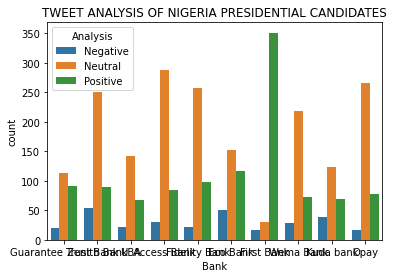

In [48]:
sns.countplot(data=tweets_df, x='Bank', hue='Analysis')
plt.title('Tweet Analysis of Nigeria Presidential Candidates'.upper())

plt.show()

In [46]:
POSTGRES_USER = 'admin'
POSTGRES_PASSWORD = 'admin'
POSTGRES_DB = 'stutern'
POSTGRES_HOST= 'localhost'

In [ ]:
engine = create_engine('postgresql+psycopg2://{0}:{1}@{2}:{3}/{4}'.format(
                            POSTGRES_USER, POSTGRES_PASSWORD, POSTGRES_HOST, 5432,POSTGRES_DB)
                        )

In [ ]:
### insert into database

tweets_df.to_sql('sentiment_analysis_banks', con=engine, index = False, if_exists = 'replace')


OperationalError: (psycopg2.OperationalError) connection to server at "localhost" (::1), port 5432 failed: FATAL:  password authentication failed for user "admin"

(Background on this error at: https://sqlalche.me/e/14/e3q8)